<font size='10'>**Multi-Class Prediction of Obesity Risk**</font>

<font size='10'>Background</font>

The continuous increase in obesity implies the growing costs and risks for individuals, society, and businesses. Furthermore, tackling obesity is one of the top government priorities in many nations. Obesity is a prevalent health issue globally, contributing to various chronic diseases and reducing overall quality of life. The goal is to prevent, reduce, and tackle obesity by helping people build healthy eating and physical habits.

<font size='10'>Objective</font>

The objective of this project is to develop a machine learning model capable of predicting the risk of obesity across multiple classes. By accurately 1) predicting obesity risk & 2) explaining the model's results, we aim to empower individuals with insights into their health status and provide healthcare professionals with a tool for early intervention and personalized recommendations.

Dataset Source: [Kaggle](https://www.kaggle.com/competitions/playground-series-s4e2)

<font size='10'>Dataset Description</font>

<table>
<thead><tr>
<th>Column</th>
<th>Full Form</th>
<th>Description</th>
<th>Variable Type</th>
</tr>
</thead>
<tbody>
<tr>
<td>'id'</td>
<td>id</td>
<td>Unique for each person(row)</td>
<td>unique integer</td>
</tr>
<tr>
<td>'Gender'</td>
<td>Gender</td>
<td>Male or Female</td>
<td>binary</td>
</tr>
<tr>
<td>'Age'</td>
<td>Age</td>
<td>Dtype is float. Age is between 14 years to 61 years</td>
<td>continuous</td>
</tr>
<tr>
<td>'Height'</td>
<td>Height</td>
<td>Height in meters</td>
<td>continuous</td>
</tr>
<tr>
<td>'Weight'</td>
<td>Weight</td>
<td>Weight in kg</td>
<td>continuous</td>
</tr>
<tr>
<td>'family_history_with_overweight'</td>
<td>family history <br> with overweight</td>
<td>Yes or No</td>
<td>binary</td>
</tr>
<tr>
<td>'FAVC'</td>
<td>Frequent consumption <br> of high calorie food</td>
<td>Yes or No</td>
<td>binary</td>
</tr>
<tr>
<td>'FCVC'</td>
<td>Frequency of <br>consumption of vegetables</td>
<td>3 values: <code>Never, Sometimes, Always</code></td>
<td>ordinal</td>
</tr>
<tr>
<td>'NCP'</td>
<td>Number of main meals per day</td>
<td>3 values: <code>1-2 meals</code>, <code>3 meals</code>, <code>more than 3 meals</code></td>
<td>ordinal</td>
</tr>
<tr>
<td>'CAEC'</td>
<td>Consumption of <br>food between meals</td>
<td>takes 4 values <code>no</code>, <code>Sometimes</code>, <code>Frequently</code>, <code>Always</code></td>
<td>ordinal</td>
</tr>
<tr>
<td>'SMOKE'</td>
<td>Smoker</td>
<td>Yes or No</td>
<td>binary</td>
</tr>
<tr>
<td>'CH2O'</td>
<td>Consumption of <br>water daily</td>
<td>3 values: <code>less than 1 litre</code>, <code>1-2 litres</code>, <code>more than 2 litres</code></td>
<td>ordinal</td>
</tr>
<tr>
<td>'SCC'</td>
<td>Calories consumption <br>monitoring</td>
<td>Yes or No</td>
<td>binary</td>
</tr>
<tr>
<td>'FAF'</td>
<td>Physical activity <br>frequency per week</td>
<td>4 values: <code>None</code>, <code>1-2 days</code>, <code>2-4 days</code>, <code>more than 4 days</code></td>
<td>ordinal</td>
</tr>
<tr>
<td>'TUE'</td>
<td>Time using technology <br>devices per day</td>
<td>3 values: <code>0-2 hours</code>, <code>3-5 hours</code>, <code>more than 5 hours</code></td>
<td>ordinal</td>
</tr>
<tr>
<td>'CALC'</td>
<td>Consumption of alcohol</td>
<td>Takes 3 values: <code>no</code>, <code>Sometimes</code>, <code>Frequently</code></td>
<td>ordinal</td>
</tr>
<tr>
<td>'MTRANS'</td>
<td>Transportation used</td>
<td>MTRANS takes 5 values <code>Public_Transportation</code>, <code>Automobile</code>, <br><code>Walking</code>, <code>Motorbike</code>, &amp; <code>Bike</code></td>
<td>categorical</td>
</tr>
<tr>
<td>'BMI'</td>
<td>Body Mass Index</td>
<td>Calculated based on Height &amp; Weight (weight in kg / (height in m)**2)</td>
<td>continuous</td>
</tr>
<tr>
<td>'ObesityRisk'</td>
<td>TARGET</td>
<td>Target variable, takes 5 possible classes.</td>
<td>Label (multi-class)</td>
</tr>
</tbody>
</table>
<p><b>ObesityRisk (Target Variable):</b></p>
<ul>
<li>Underweight : Less than 18.5</li>
<li>Normal_Weight       : 18.5 to 24.9</li>
<li>Overweight: 25.0 to 29.9</li>
<li>Obesity      : 30.0 to 34.9</li>
<li>Obesity_Severe     : Higher than 35.0</li>
</ul>

<font size='10'>Outline</font>

1. Import Libraries 
2. Data Overview
3. Data Cleaning
4. EDA
5. Feature Engineering
6. Modeling

<font size='10'>Import Libraries</font>

In [57]:
# Basic
import os
import zipfile
import numpy as np
import pandas as pd

# Visualizations
import matplotlib.pyplot as plt
import seaborn as sns


# Scikit-learn 
from sklearn.metrics import accuracy_score
from sklearn.model_selection import KFold, GridSearchCV, train_test_split
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, LabelEncoder, OneHotEncoder
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
# ligtGBM
from lightgbm import LGBMClassifier

# xgboost
from xgboost import XGBRFClassifier

<font size='10'>Unzip the file</font>

In [3]:
# with zipfile.ZipFile('D:\Machinelearning\Course\Project_Course3\Dataset\playground-series-s4e2.zip') as zipp:
#     zipp.extractall()

<font size='10'>Create a folder to store extracted files</font>

In [4]:
# filename='Obesity_risk'
# os.makedirs(filename,exist_ok=True)

In [5]:
# # push files into the folder
# store_files=['sample_submission.csv','test.csv','train.csv']
# for file in store_files:
#     os.rename(file,os.path.join('Obesity_risk',file))


<font size='10'>Open files</font>

In [6]:
training_data=pd.read_csv("Obesity_risk/train.csv")
test_data=pd.read_csv("Obesity_risk/test.csv")


<font size='10'>Data Overview</font>

In [7]:
training_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20758 entries, 0 to 20757
Data columns (total 18 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              20758 non-null  int64  
 1   Gender                          20758 non-null  object 
 2   Age                             20758 non-null  float64
 3   Height                          20758 non-null  float64
 4   Weight                          20758 non-null  float64
 5   family_history_with_overweight  20758 non-null  object 
 6   FAVC                            20758 non-null  object 
 7   FCVC                            20758 non-null  float64
 8   NCP                             20758 non-null  float64
 9   CAEC                            20758 non-null  object 
 10  SMOKE                           20758 non-null  object 
 11  CH2O                            20758 non-null  float64
 12  SCC                             

In [8]:
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13840 entries, 0 to 13839
Data columns (total 17 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   id                              13840 non-null  int64  
 1   Gender                          13840 non-null  object 
 2   Age                             13840 non-null  float64
 3   Height                          13840 non-null  float64
 4   Weight                          13840 non-null  float64
 5   family_history_with_overweight  13840 non-null  object 
 6   FAVC                            13840 non-null  object 
 7   FCVC                            13840 non-null  float64
 8   NCP                             13840 non-null  float64
 9   CAEC                            13840 non-null  object 
 10  SMOKE                           13840 non-null  object 
 11  CH2O                            13840 non-null  float64
 12  SCC                             

In [9]:
training_data.describe()

,id,Age,Height,Weight,FCVC,NCP,CH2O,FAF,TUE
count,20758.00000,20758.000000,20758.000000,20758.000000,20758.000000,20758.000000,20758.000000,20758.000000,20758.000000
mean,10378.50000,23.841804,1.700245,87.887768,2.445908,2.761332,2.029418,0.981747,0.616756
std,5992.46278,5.688072,0.087312,26.379443,0.533218,0.705375,0.608467,0.838302,0.602113
min,0.00000,14.000000,1.450000,39.000000,1.000000,1.000000,1.000000,0.000000,0.000000
25%,5189.25000,20.000000,1.631856,66.000000,2.000000,3.000000,1.792022,0.008013,0.000000
50%,10378.50000,22.815416,1.700000,84.064875,2.393837,3.000000,2.000000,1.000000,0.573887
75%,15567.75000,26.000000,1.762887,111.600553,3.000000,3.000000,2.549617,1.587406,1.000000
max,20757.00000,61.000000,1.975663,165.057269,3.000000,4.000000,3.000000,3.000000,2.000000


In [10]:
test_data.describe()

,id,Age,Height,Weight,FCVC,NCP,CH2O,FAF,TUE
count,13840.000000,13840.000000,13840.000000,13840.000000,13840.000000,13840.000000,13840.000000,13840.000000,13840.000000
mean,27677.500000,23.952740,1.698934,87.384504,2.442898,2.750610,2.032044,0.974532,0.611033
std,3995.408198,5.799814,0.088761,26.111819,0.531606,0.710927,0.611230,0.840361,0.608005
min,20758.000000,14.000000,1.450000,39.000000,1.000000,1.000000,1.000000,0.000000,0.000000
25%,24217.750000,20.000000,1.631662,65.000000,2.000000,3.000000,1.771781,0.001086,0.000000
50%,27677.500000,22.906342,1.700000,83.952968,2.358087,3.000000,2.000000,1.000000,0.552498
75%,31137.250000,26.000000,1.760710,111.157811,3.000000,3.000000,2.552388,1.571865,1.000000
max,34597.000000,61.000000,1.980000,165.057269,3.000000,4.000000,3.000000,3.000000,2.000000


In [11]:
training_data.head()

,id,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,SMOKE,CH2O,SCC,FAF,TUE,CALC,MTRANS,NObeyesdad
0,0,Male,24.443011,1.699998,81.669950,yes,yes,2.000000,2.983297,Sometimes,no,2.763573,no,0.000000,0.976473,Sometimes,Public_Transportation,Overweight_Level_II
1,1,Female,18.000000,1.560000,57.000000,yes,yes,2.000000,3.000000,Frequently,no,2.000000,no,1.000000,1.000000,no,Automobile,Normal_Weight
2,2,Female,18.000000,1.711460,50.165754,yes,yes,1.880534,1.411685,Sometimes,no,1.910378,no,0.866045,1.673584,no,Public_Transportation,Insufficient_Weight
3,3,Female,20.952737,1.710730,131.274851,yes,yes,3.000000,3.000000,Sometimes,no,1.674061,no,1.467863,0.780199,Sometimes,Public_Transportation,Obesity_Type_III
4,4,Male,31.641081,1.914186,93.798055,yes,yes,2.679664,1.971472,Sometimes,no,1.979848,no,1.967973,0.931721,Sometimes,Public_Transportation,Overweight_Level_II


<font size='10'>**Cleaning Data**</font>

In [12]:
df=pd.concat((training_data,test_data),ignore_index=True)

In [13]:
df

,id,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,SMOKE,CH2O,SCC,FAF,TUE,CALC,MTRANS,NObeyesdad
0,0,Male,24.443011,1.699998,81.669950,yes,yes,2.000000,2.983297,Sometimes,no,2.763573,no,0.000000,0.976473,Sometimes,Public_Transportation,Overweight_Level_II
1,1,Female,18.000000,1.560000,57.000000,yes,yes,2.000000,3.000000,Frequently,no,2.000000,no,1.000000,1.000000,no,Automobile,Normal_Weight
2,2,Female,18.000000,1.711460,50.165754,yes,yes,1.880534,1.411685,Sometimes,no,1.910378,no,0.866045,1.673584,no,Public_Transportation,Insufficient_Weight
3,3,Female,20.952737,1.710730,131.274851,yes,yes,3.000000,3.000000,Sometimes,no,1.674061,no,1.467863,0.780199,Sometimes,Public_Transportation,Obesity_Type_III
4,4,Male,31.641081,1.914186,93.798055,yes,yes,2.679664,1.971472,Sometimes,no,1.979848,no,1.967973,0.931721,Sometimes,Public_Transportation,Overweight_Level_II
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34593,34593,Male,23.327836,1.721384,78.030383,yes,no,2.813234,3.000000,Sometimes,no,1.000000,no,0.807076,0.778632,Sometimes,Public_Transportation,NaN
34594,34594,Female,29.000000,1.590000,62.000000,no,yes,3.000000,3.000000,Sometimes,no,2.000000,no,0.000000,0.000000,Sometimes,Public_Transportation,NaN
34595,34595,Female,22.935612,1.585547,44.376637,no,yes,3.000000,2.273740,Frequently,no,2.000000,no,1.949840,1.000000,Sometimes,Public_Transportation,NaN
34596,34596,Male,21.000000,1.620000,53.000000,yes,yes,2.000000,3.000000,Sometimes,no,2.000000,no,3.000000,2.000000,no,Public_Transportation,NaN


**Drop unneccessary columns**

In [14]:
df.drop("id",axis=1,inplace=True)

In [15]:
df.isnull().sum()

Gender                                0
Age                                   0
Height                                0
Weight                                0
family_history_with_overweight        0
FAVC                                  0
FCVC                                  0
NCP                                   0
CAEC                                  0
SMOKE                                 0
CH2O                                  0
SCC                                   0
FAF                                   0
TUE                                   0
CALC                                  0
MTRANS                                0
NObeyesdad                        13840
dtype: int64

In [16]:
df

,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,SMOKE,CH2O,SCC,FAF,TUE,CALC,MTRANS,NObeyesdad
0,Male,24.443011,1.699998,81.669950,yes,yes,2.000000,2.983297,Sometimes,no,2.763573,no,0.000000,0.976473,Sometimes,Public_Transportation,Overweight_Level_II
1,Female,18.000000,1.560000,57.000000,yes,yes,2.000000,3.000000,Frequently,no,2.000000,no,1.000000,1.000000,no,Automobile,Normal_Weight
2,Female,18.000000,1.711460,50.165754,yes,yes,1.880534,1.411685,Sometimes,no,1.910378,no,0.866045,1.673584,no,Public_Transportation,Insufficient_Weight
3,Female,20.952737,1.710730,131.274851,yes,yes,3.000000,3.000000,Sometimes,no,1.674061,no,1.467863,0.780199,Sometimes,Public_Transportation,Obesity_Type_III
4,Male,31.641081,1.914186,93.798055,yes,yes,2.679664,1.971472,Sometimes,no,1.979848,no,1.967973,0.931721,Sometimes,Public_Transportation,Overweight_Level_II
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34593,Male,23.327836,1.721384,78.030383,yes,no,2.813234,3.000000,Sometimes,no,1.000000,no,0.807076,0.778632,Sometimes,Public_Transportation,NaN
34594,Female,29.000000,1.590000,62.000000,no,yes,3.000000,3.000000,Sometimes,no,2.000000,no,0.000000,0.000000,Sometimes,Public_Transportation,NaN
34595,Female,22.935612,1.585547,44.376637,no,yes,3.000000,2.273740,Frequently,no,2.000000,no,1.949840,1.000000,Sometimes,Public_Transportation,NaN
34596,Male,21.000000,1.620000,53.000000,yes,yes,2.000000,3.000000,Sometimes,no,2.000000,no,3.000000,2.000000,no,Public_Transportation,NaN


In [17]:
def Overview(Dataframe):
    d={'Index': Dataframe.index,
       'Columns':Dataframe.columns,
       'Shape': Dataframe.shape,
       'Datatype': Dataframe.dtypes,
       'Number of values': Dataframe.nunique(),
       'Value': Dataframe.value_counts(),
        'Describe': Dataframe.describe([0.01,0.1,0.5,0.75,0.99]).T
        }
    Hash_tag='*'*80
    for key,val in d.items():
        print(Hash_tag,key,Hash_tag)
        print(val)
    print(Hash_tag,"ENDLIST",Hash_tag)

In [18]:
Overview(df)

******************************************************************************** Index ********************************************************************************
RangeIndex(start=0, stop=34598, step=1)
******************************************************************************** Columns ********************************************************************************
Index(['Gender', 'Age', 'Height', 'Weight', 'family_history_with_overweight',
       'FAVC', 'FCVC', 'NCP', 'CAEC', 'SMOKE', 'CH2O', 'SCC', 'FAF', 'TUE',
       'CALC', 'MTRANS', 'NObeyesdad'],
      dtype='object')
******************************************************************************** Shape ********************************************************************************
(34598, 17)
******************************************************************************** Datatype ********************************************************************************
Gender                             object
Age          

<font size='10'>Exploratory Data Analysis</font>

In [19]:
def classify(df, cat_th=10, car_th=20):
    num_cols=df.columns[df.dtypes!='object'].to_list()
    cat_cols=df.columns[df.dtypes=='object']

    num_but_cat=df.columns[(df.nunique()<cat_th) & (df.dtypes!='object')].to_list()
    cat_but_car=df.columns[(df.nunique()>car_th) & (df.dtypes=='object')]

    num_cols=[col for col in num_cols if col not in num_but_cat]
    cat_cols=[col for col in cat_cols if col not in cat_but_car]
    cat_cols+=num_but_cat

    print('Observation: ', df.shape[0])
    print('variables:', df.shape[1])
    print('cat_cols: ',  len(cat_cols))
    print('num_cols: ', len(num_cols))
    print('cat_but_car: ', len(cat_but_car))

    return cat_cols,num_cols,cat_but_car


In [20]:
cat_cols,num_cols,cat_but_car= classify(df)

Observation:  34598
variables: 17
cat_cols:  9
num_cols:  8
cat_but_car:  0


In [21]:
def to_analysis_cat(dataframe, c_cols, ratio=False, plot=False):
    print('-' * 80)
    if dataframe[c_cols].dtype == 'bool':
        dataframe[c_cols] = dataframe[c_cols].astype(int)

    if ratio:
        print(pd.DataFrame({c_cols: dataframe[c_cols].value_counts(),
                            'Ratio (%)': 100 * dataframe[c_cols].value_counts() / len(dataframe)}))
    print('-' * 80)
    if plot:
        values = dataframe[c_cols].value_counts()
        fig, axes = plt.subplots(1, len(values), figsize=(len(values) * 8, 9))

        for i, (index, value) in enumerate(values.items()):
            ax = axes[i]
            ax.pie([value, len(dataframe) - value], labels=[f'{index} ({value})', f'Others ({len(dataframe) - value})'],
                   colors=['#94bcfb', '#bad6fc', '#fffacd'], autopct='%1.1f%%', startangle=90)
            ax.set_title(f'{c_cols} - {index}')
            ax.axis('equal') 

        plt.suptitle(f'RATIO by {c_cols}', y=1.05, fontsize=20)
        plt.tight_layout()
        plt.show()

--------------------------------------------------------------------------------
        Gender  Ratio (%)
Gender                   
Female   17387   50.25435
Male     17211   49.74565
--------------------------------------------------------------------------------


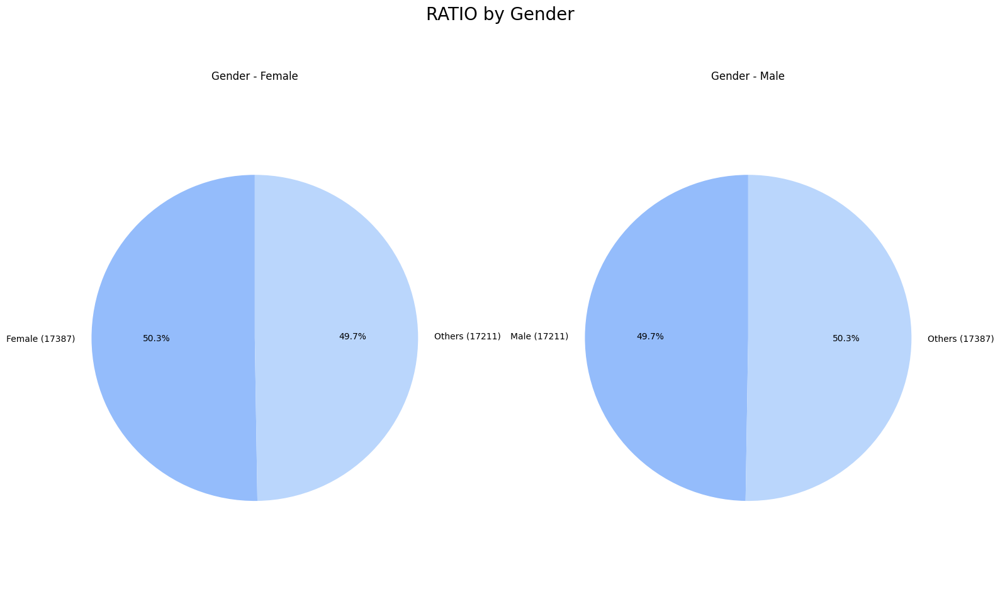

--------------------------------------------------------------------------------
                                family_history_with_overweight  Ratio (%)
family_history_with_overweight                                           
yes                                                      28398  82.079889
no                                                        6200  17.920111
--------------------------------------------------------------------------------


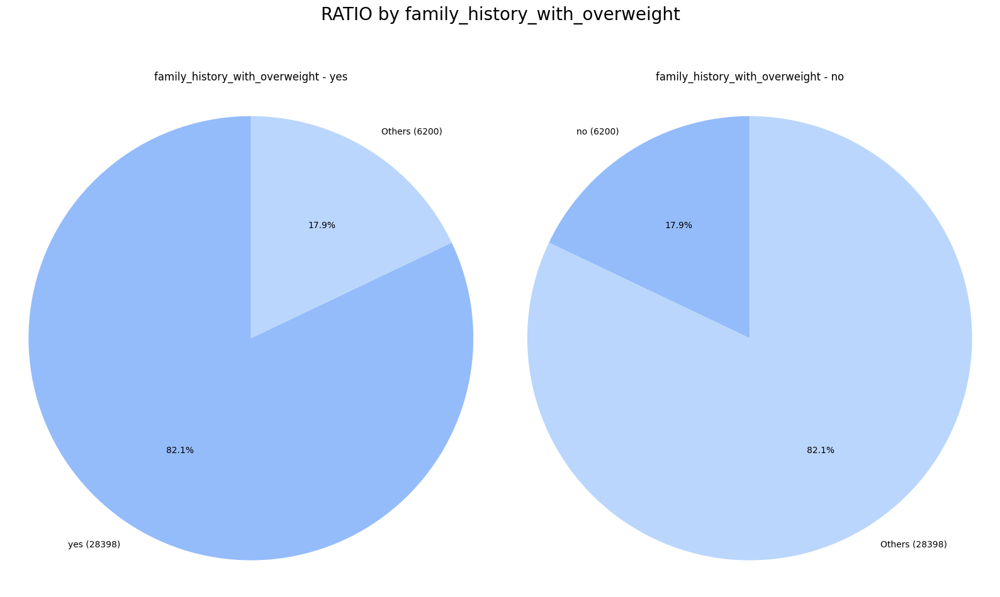

--------------------------------------------------------------------------------
       FAVC  Ratio (%)
FAVC                  
yes   31565  91.233597
no     3033   8.766403
--------------------------------------------------------------------------------


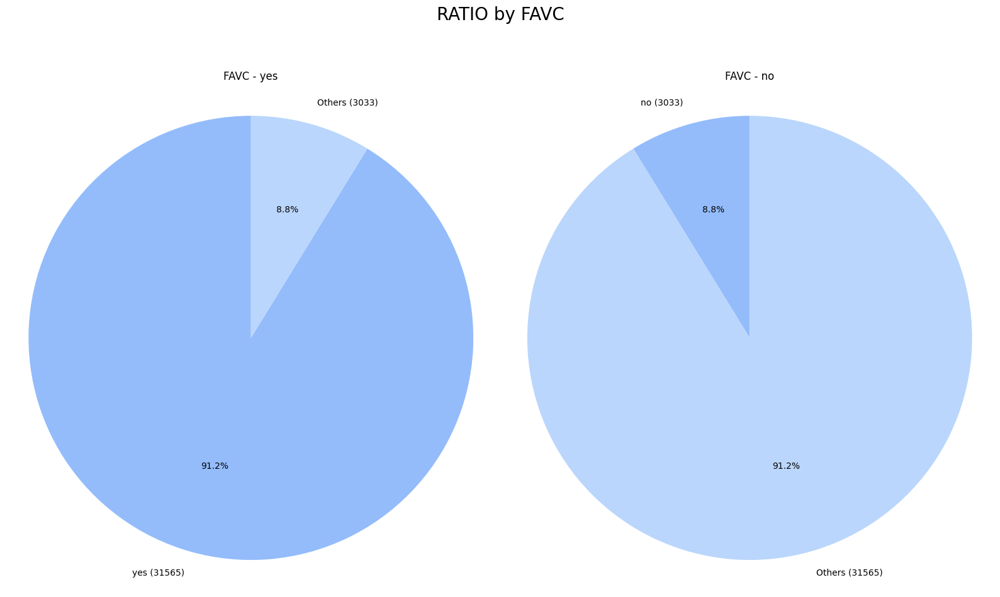

--------------------------------------------------------------------------------
             CAEC  Ratio (%)
CAEC                        
Sometimes   29218  84.449968
Frequently   4089  11.818602
Always        837   2.419215
no            454   1.312215
--------------------------------------------------------------------------------


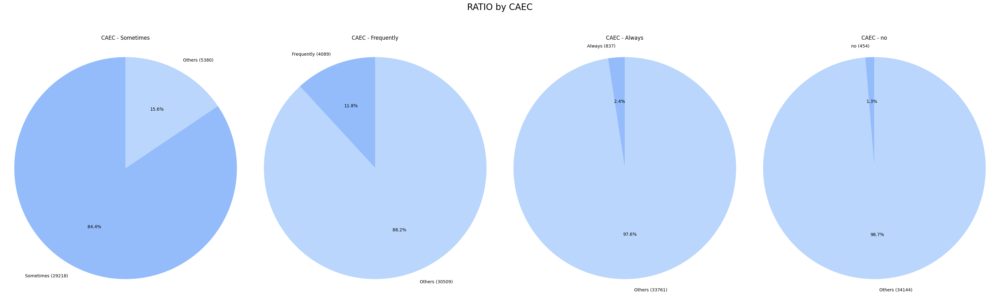

--------------------------------------------------------------------------------
       SMOKE  Ratio (%)
SMOKE                  
no     34173  98.771605
yes      425   1.228395
--------------------------------------------------------------------------------


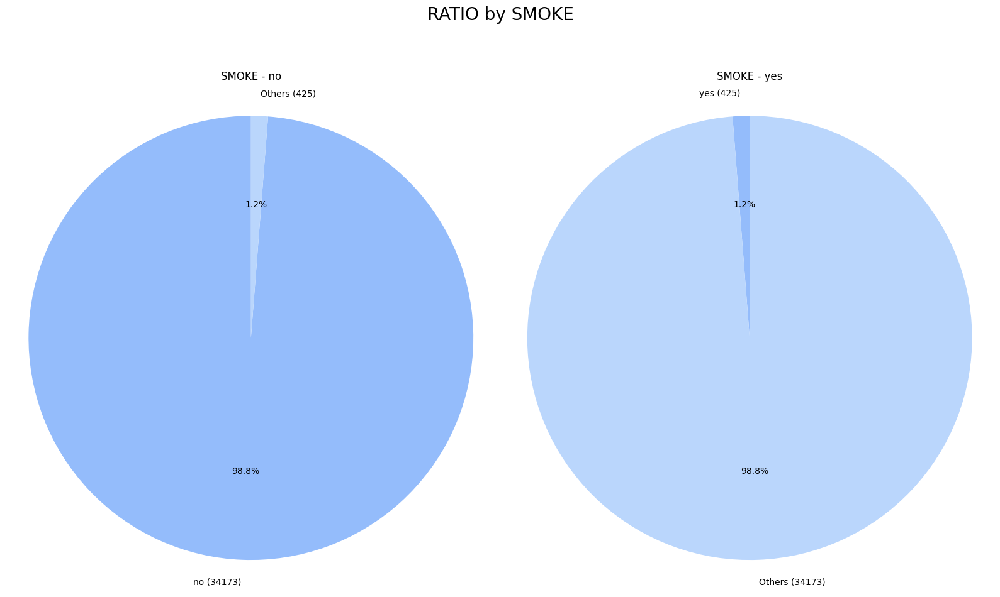

--------------------------------------------------------------------------------
       SCC  Ratio (%)
SCC                  
no   33447  96.673218
yes   1151   3.326782
--------------------------------------------------------------------------------


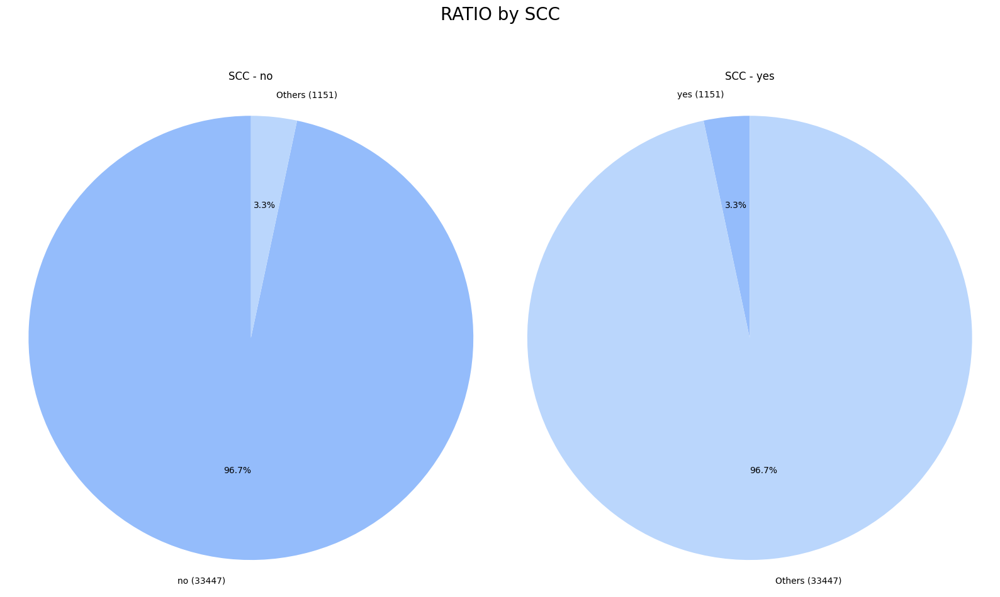

--------------------------------------------------------------------------------
             CALC  Ratio (%)
CALC                        
Sometimes   25045  72.388577
no           8676  25.076594
Frequently    875   2.529048
Always          2   0.005781
--------------------------------------------------------------------------------


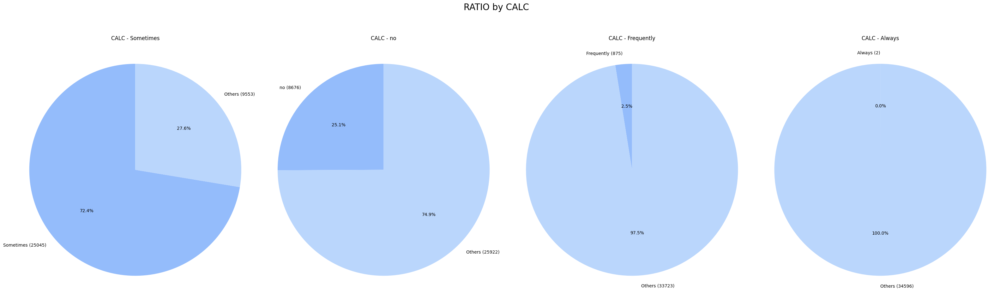

--------------------------------------------------------------------------------
                       MTRANS  Ratio (%)
MTRANS                                  
Public_Transportation   27798  80.345685
Automobile               5939  17.165732
Walking                   747   2.159084
Motorbike                  57   0.164749
Bike                       57   0.164749
--------------------------------------------------------------------------------


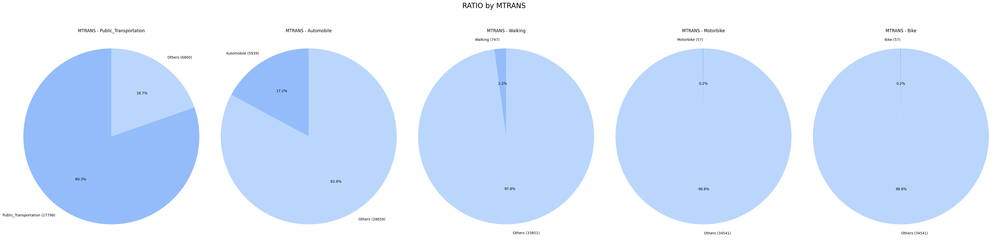

--------------------------------------------------------------------------------
                     NObeyesdad  Ratio (%)
NObeyesdad                                
Obesity_Type_III           4046  11.694318
Obesity_Type_II            3248   9.387826
Normal_Weight              3082   8.908029
Obesity_Type_I             2910   8.410891
Insufficient_Weight        2523   7.292329
Overweight_Level_II        2522   7.289439
Overweight_Level_I         2427   7.014856
--------------------------------------------------------------------------------


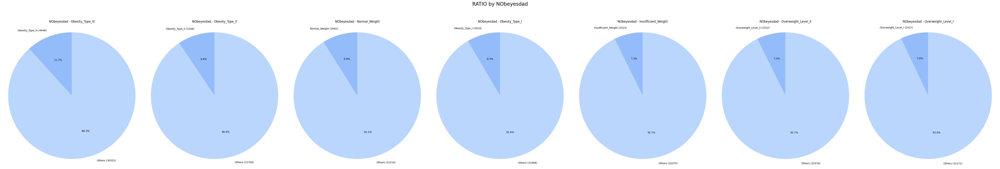

In [22]:
for col in cat_cols:
    to_analysis_cat(df,col,ratio=True,plot=True)

In [23]:
def analysis_by_target(df, col, target_col="NObeyesdad"):
    plt.figure(figsize=(10,10))
    sns.countplot(df,x=col, hue=target_col)
    plt.tight_layout()
    plt.show()

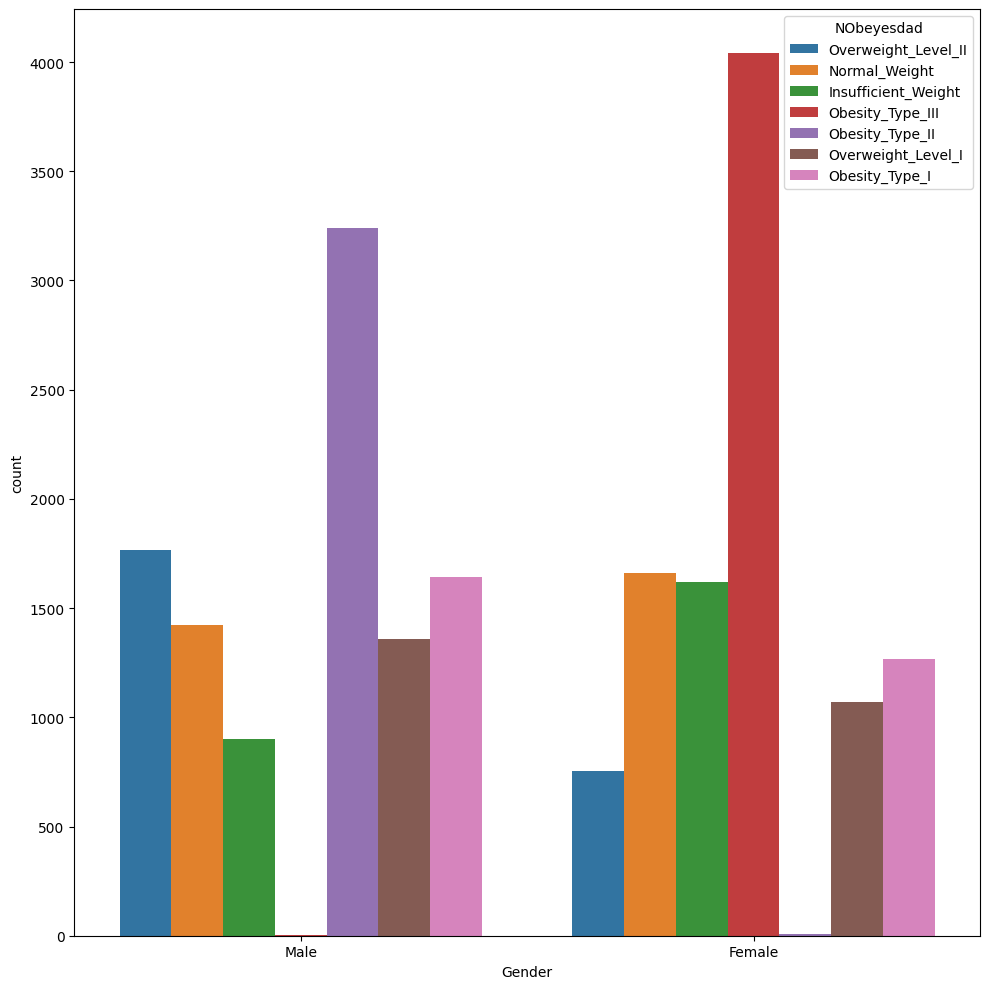

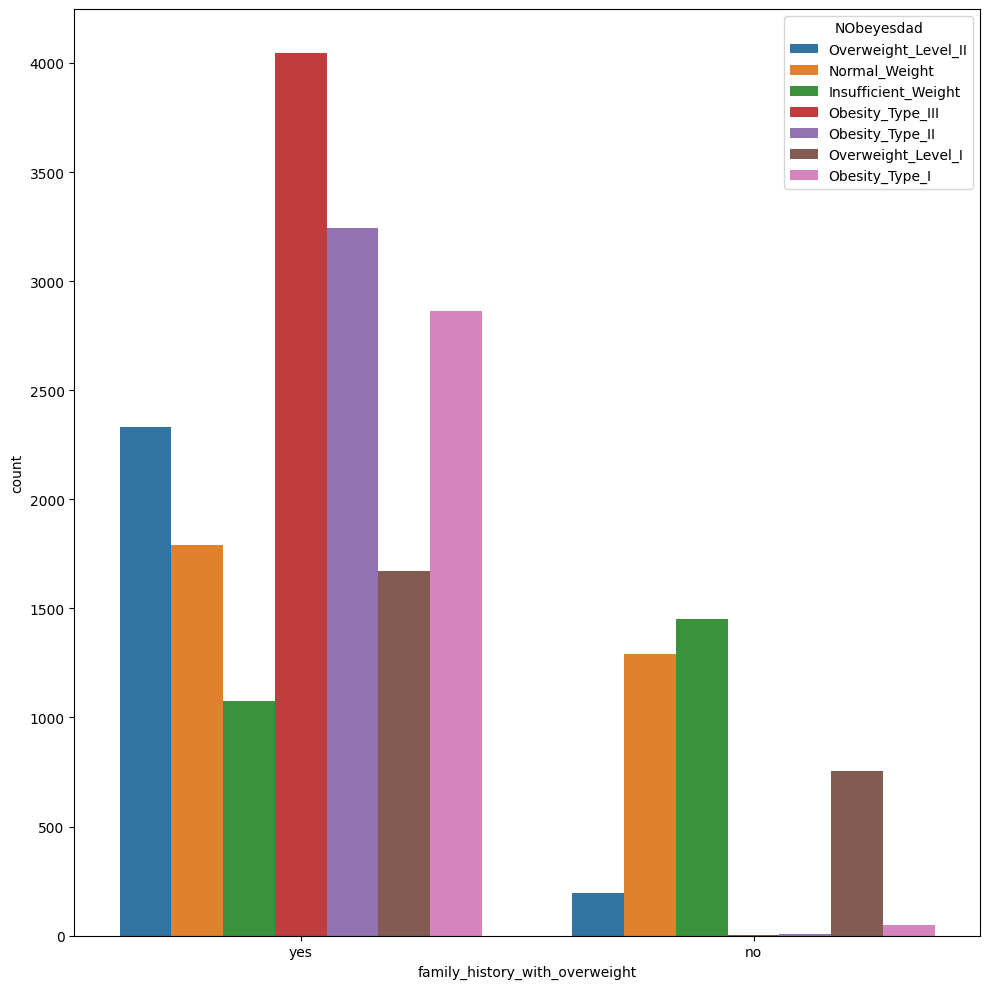

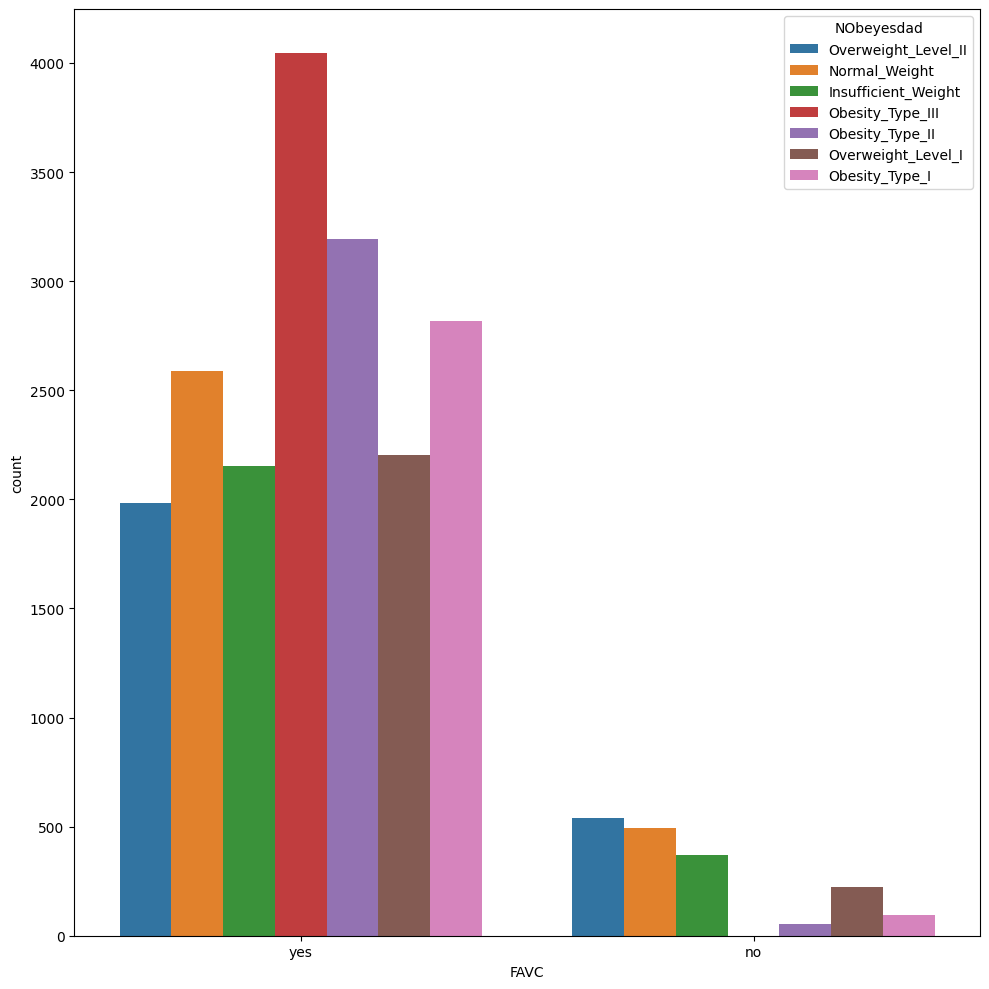

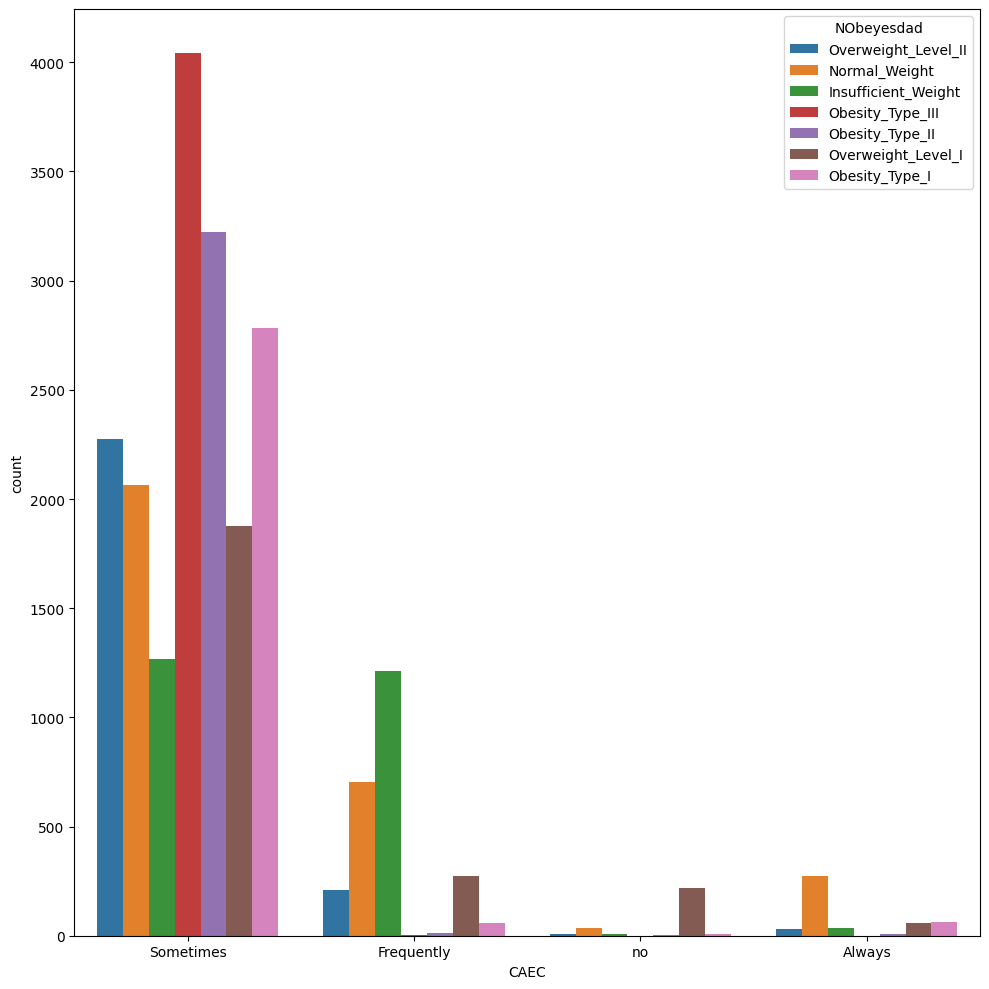

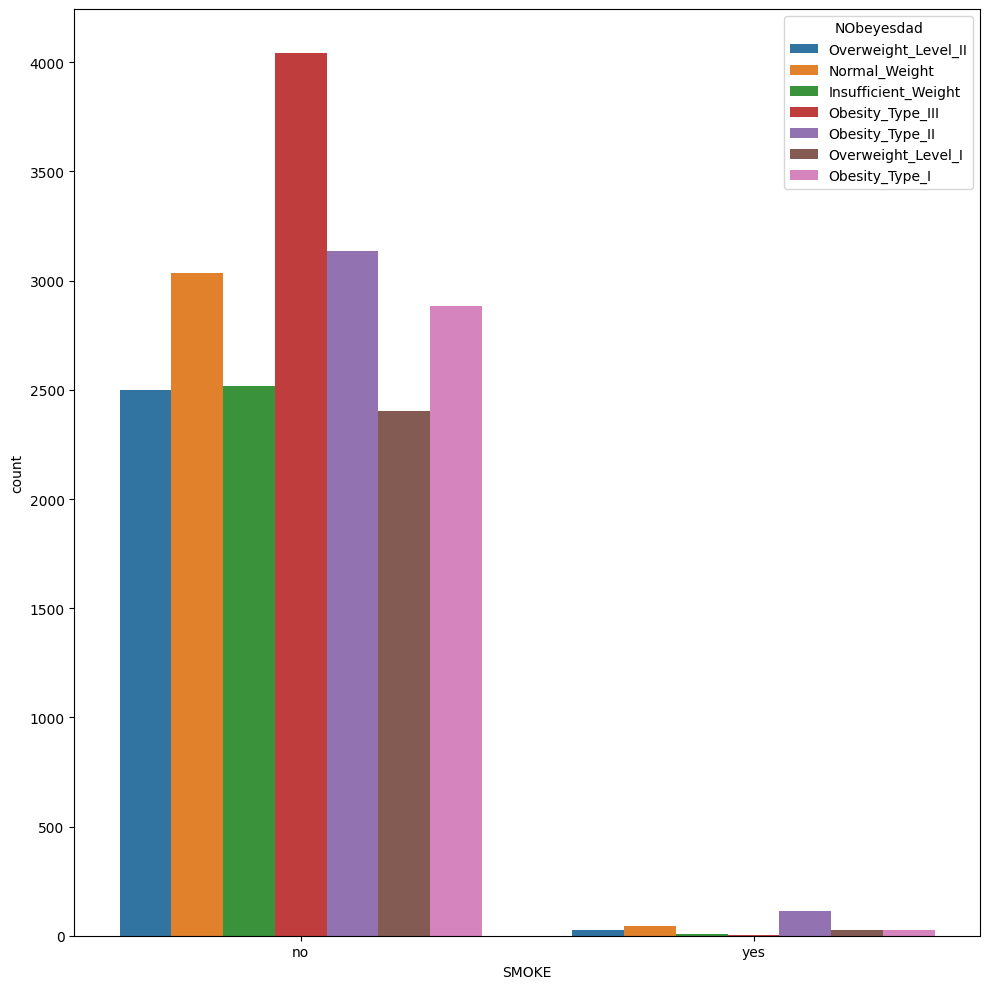

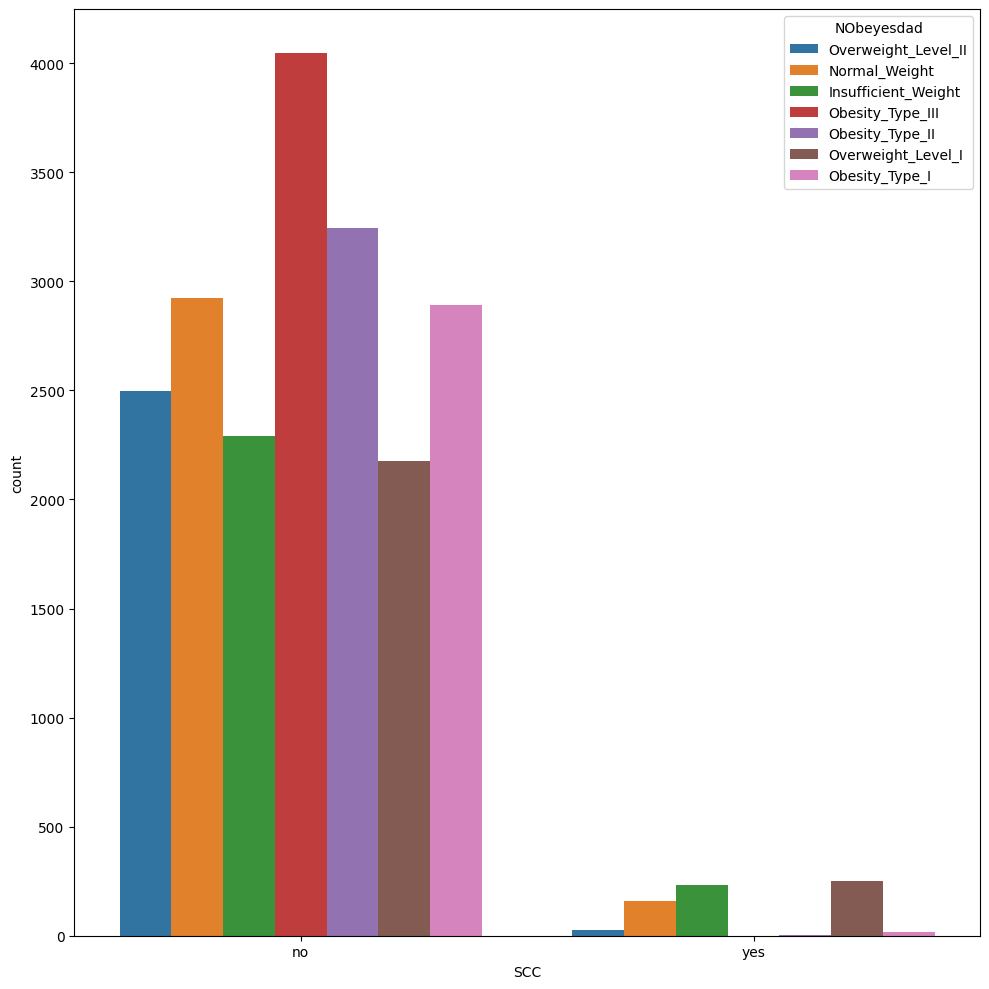

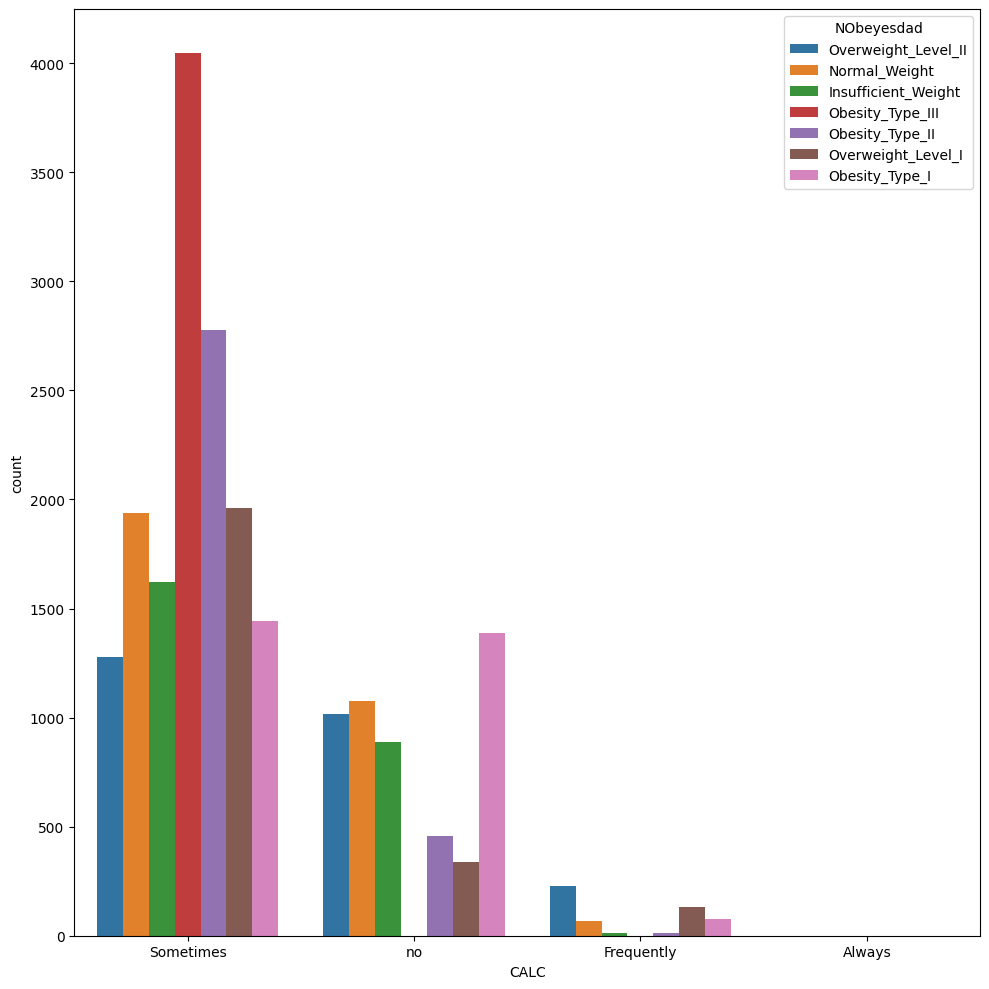

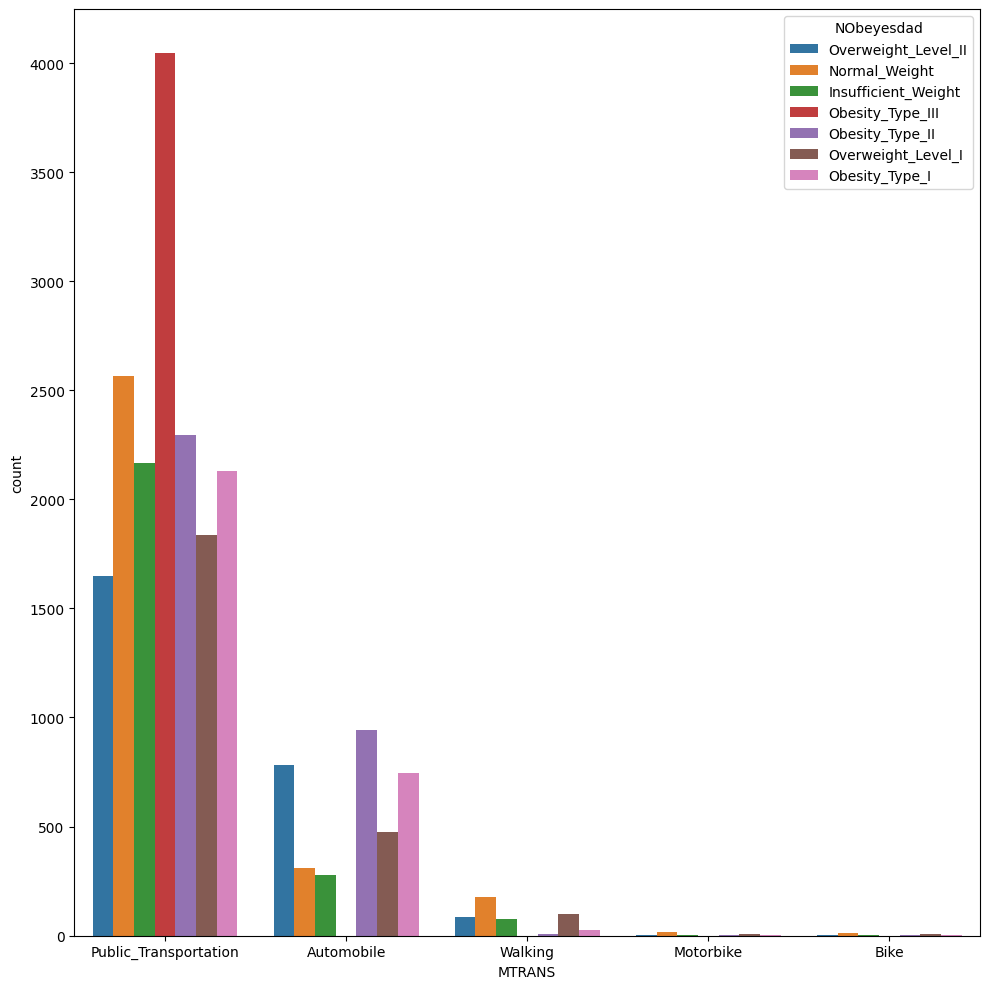

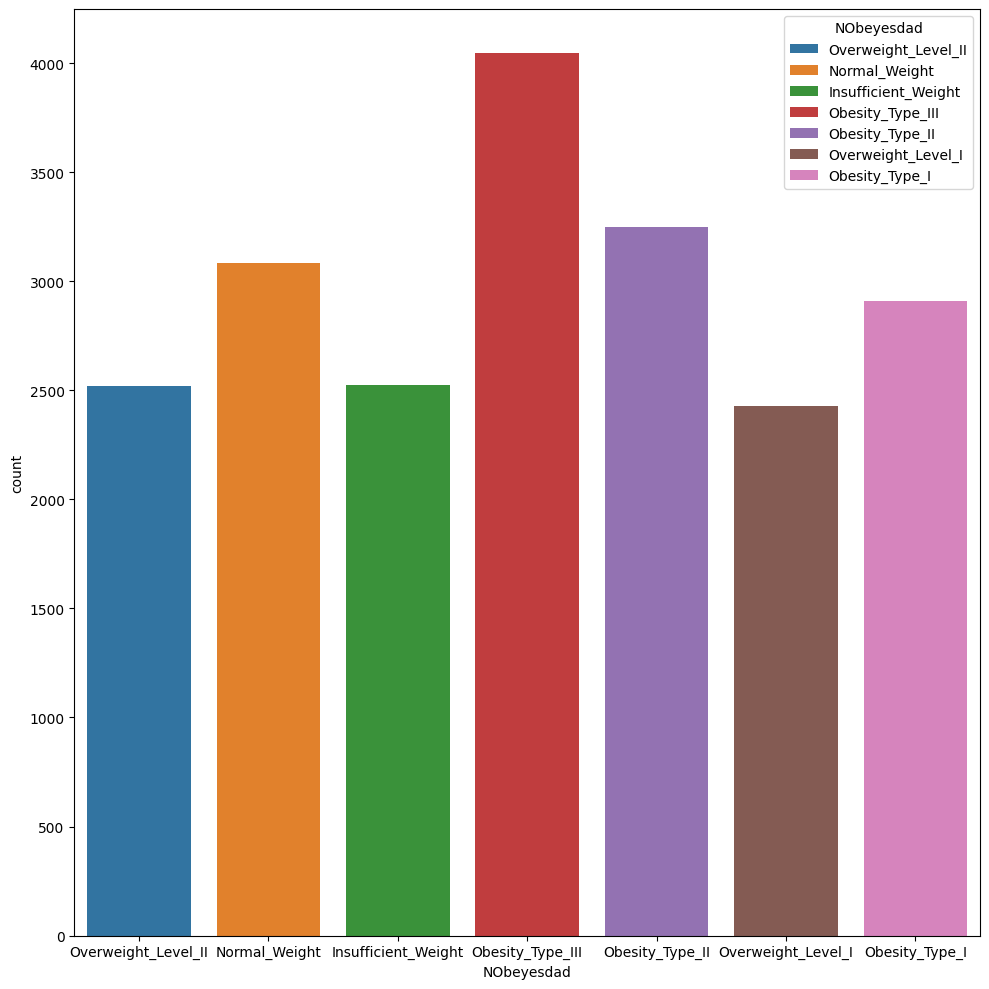

In [24]:
for col in cat_cols:
    analysis_by_target(df,col)

<font size='10'>Numerical Data</font>

In [25]:
def to_analysis_num(df,num_cols, target_col="NObeyesdad"):
    for col in num_cols:
        plt.figure(figsize=(10,10))

        plt.subplot(1,2,1)
        sns.histplot(df,x=col,hue=target_col,bins=30,alpha=0.3)

        plt.subplot(1,2,2)
        sns.boxplot(df,x=col)

        plt.tight_layout()
        plt.show()
        plt.close()

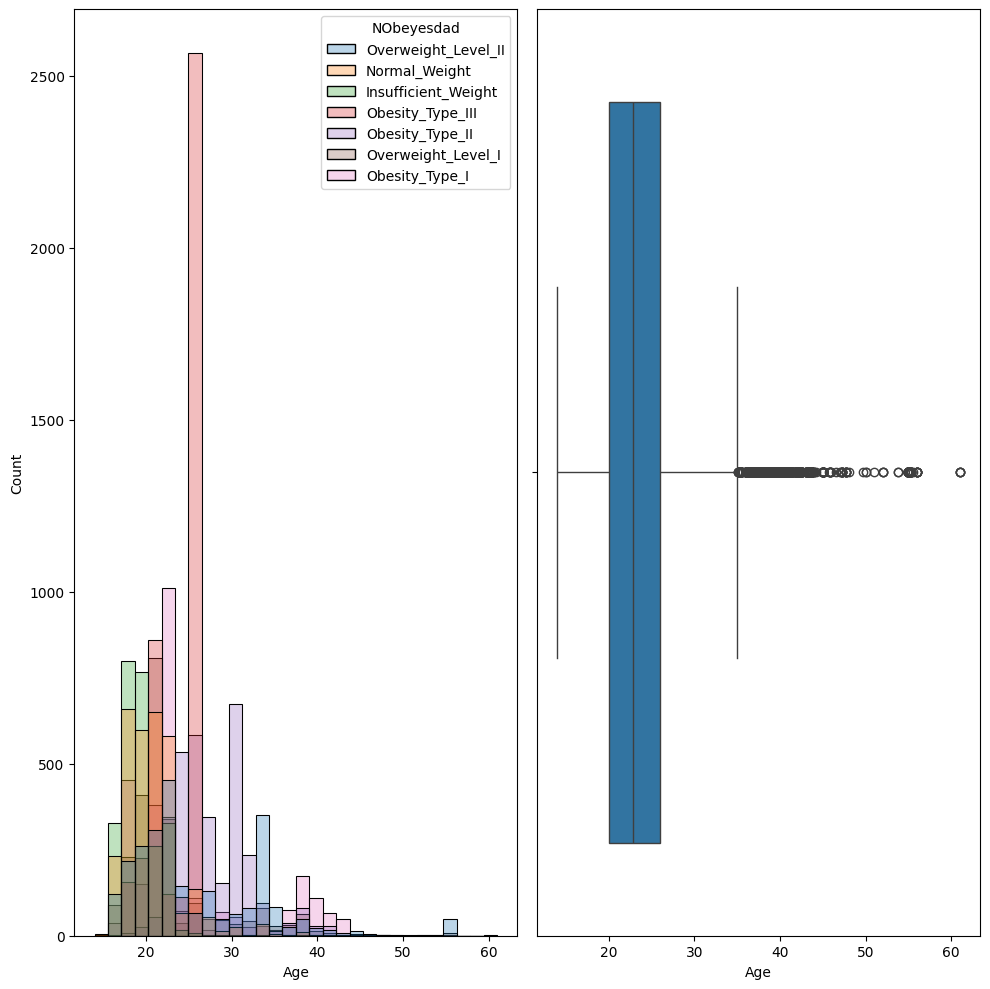

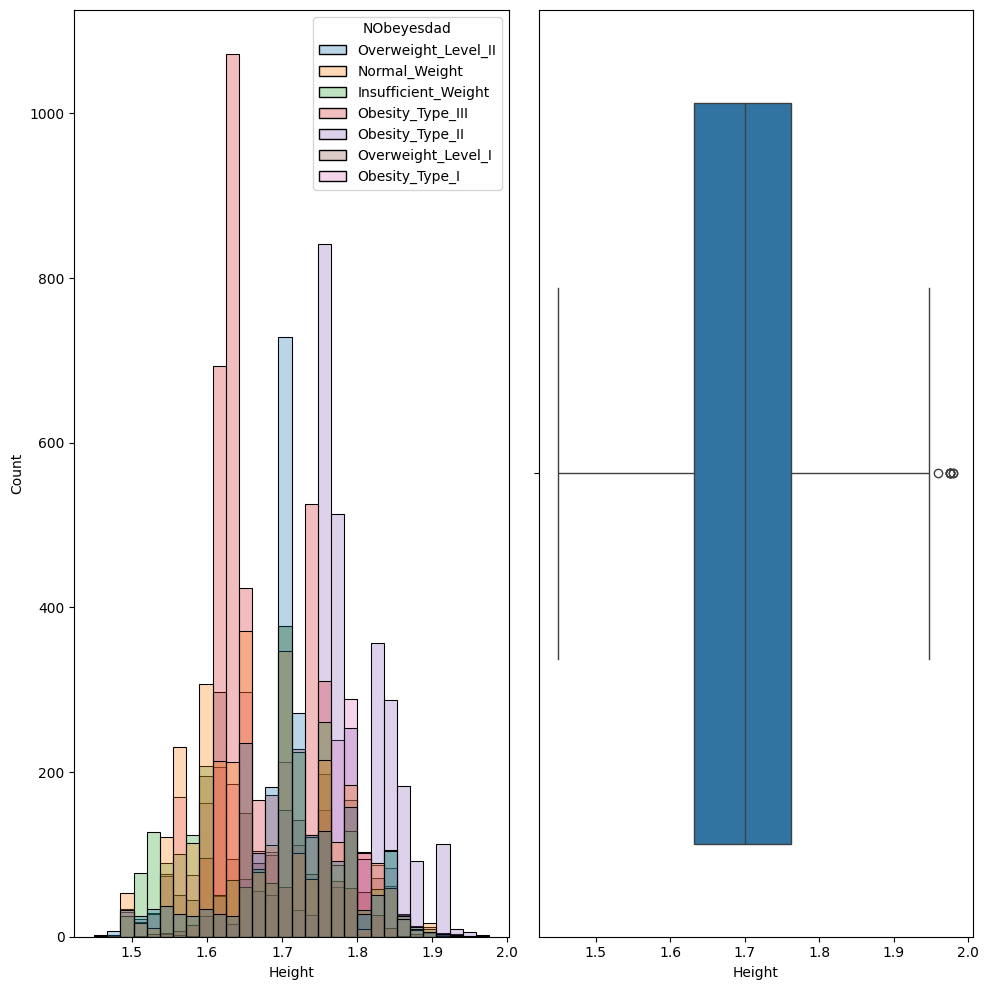

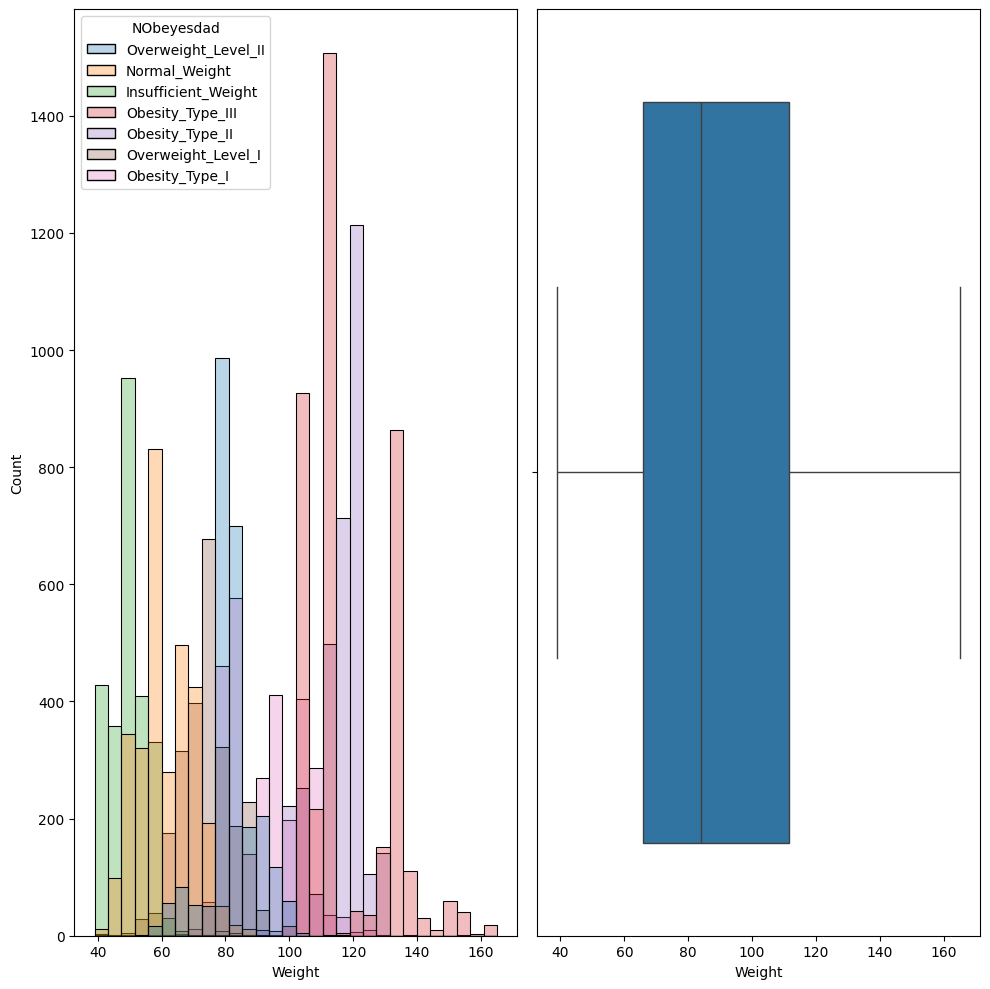

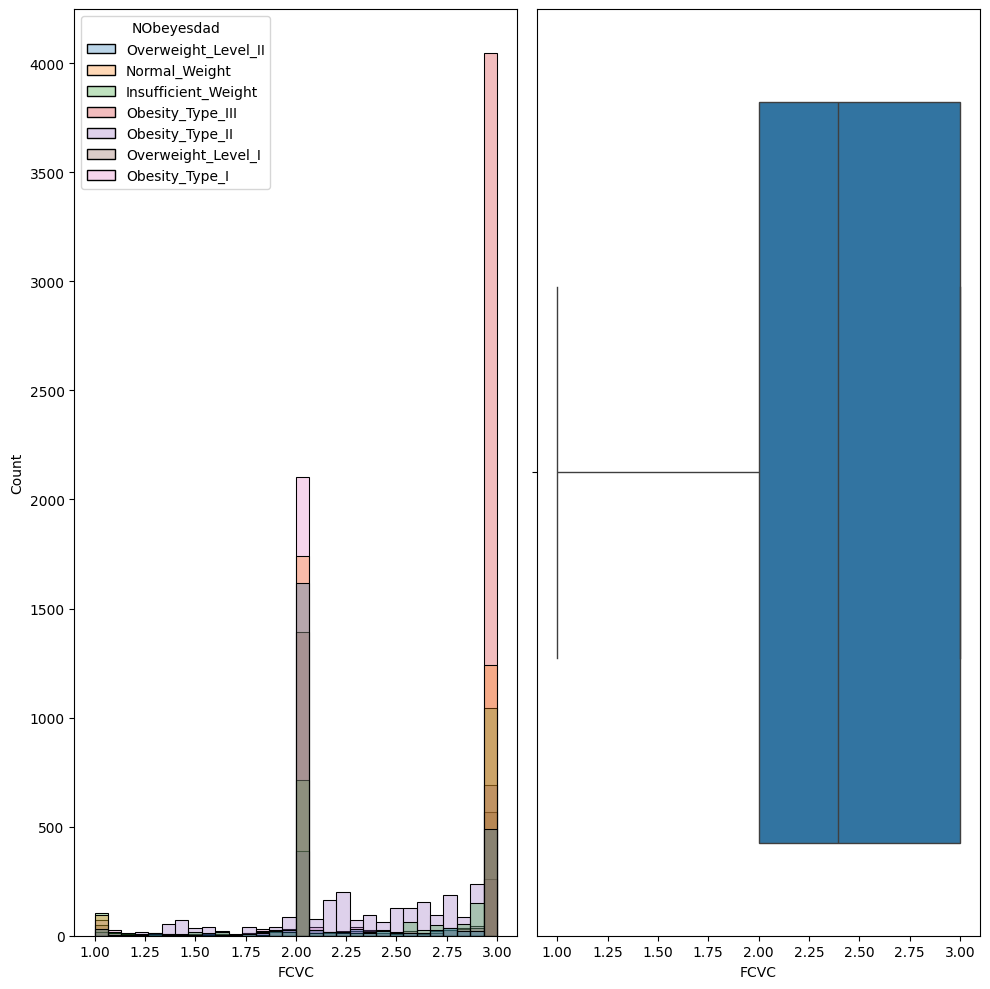

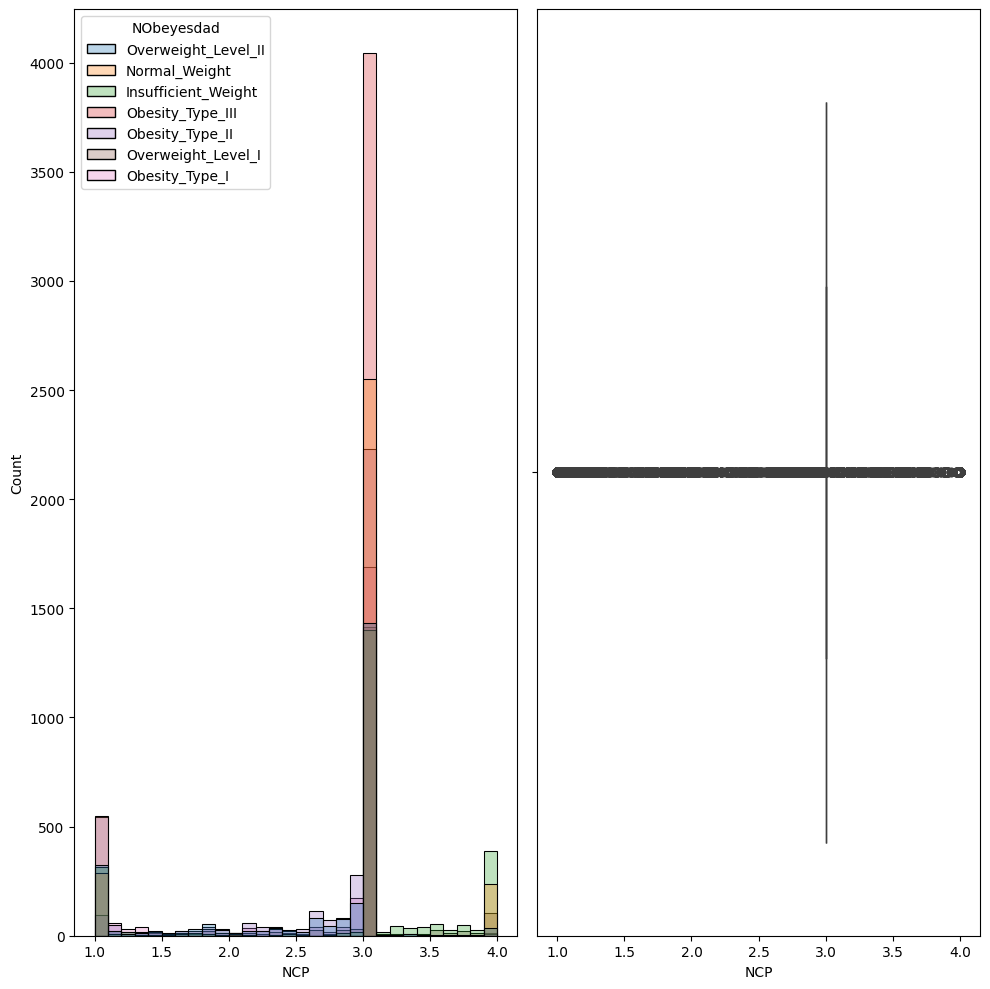

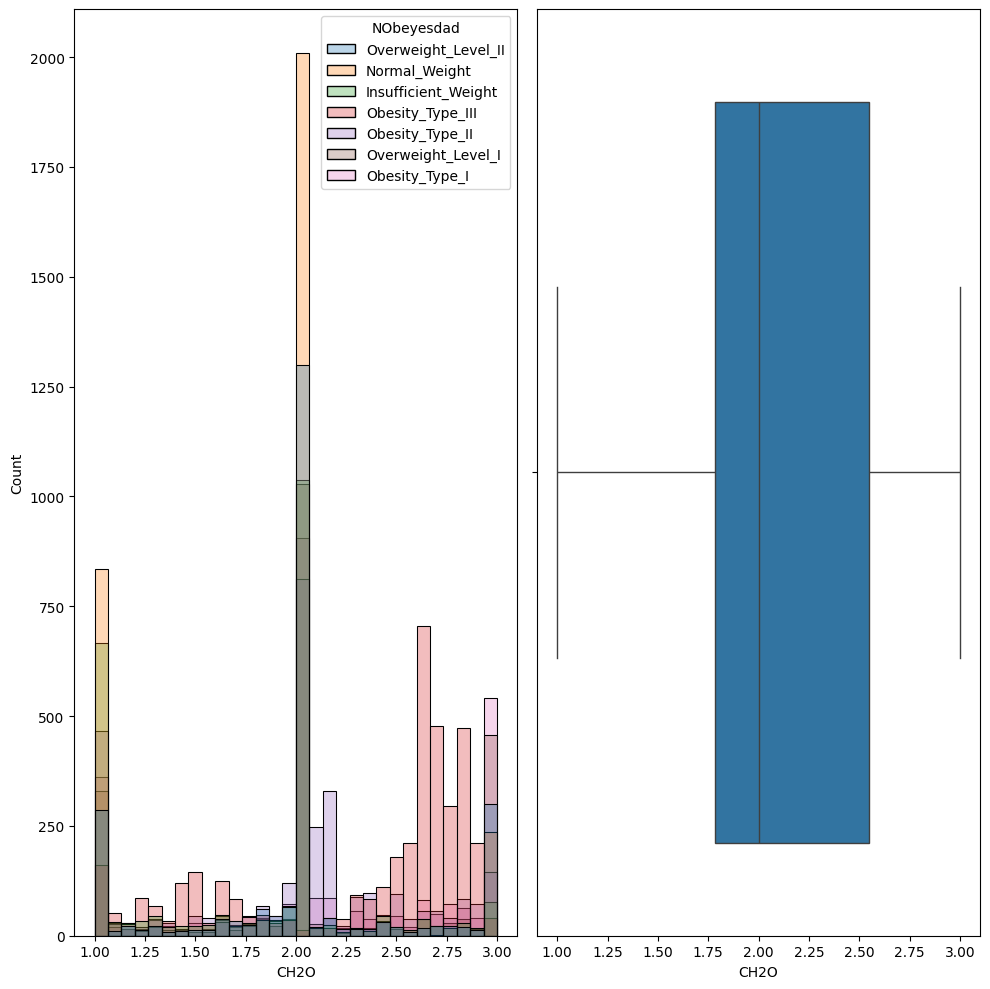

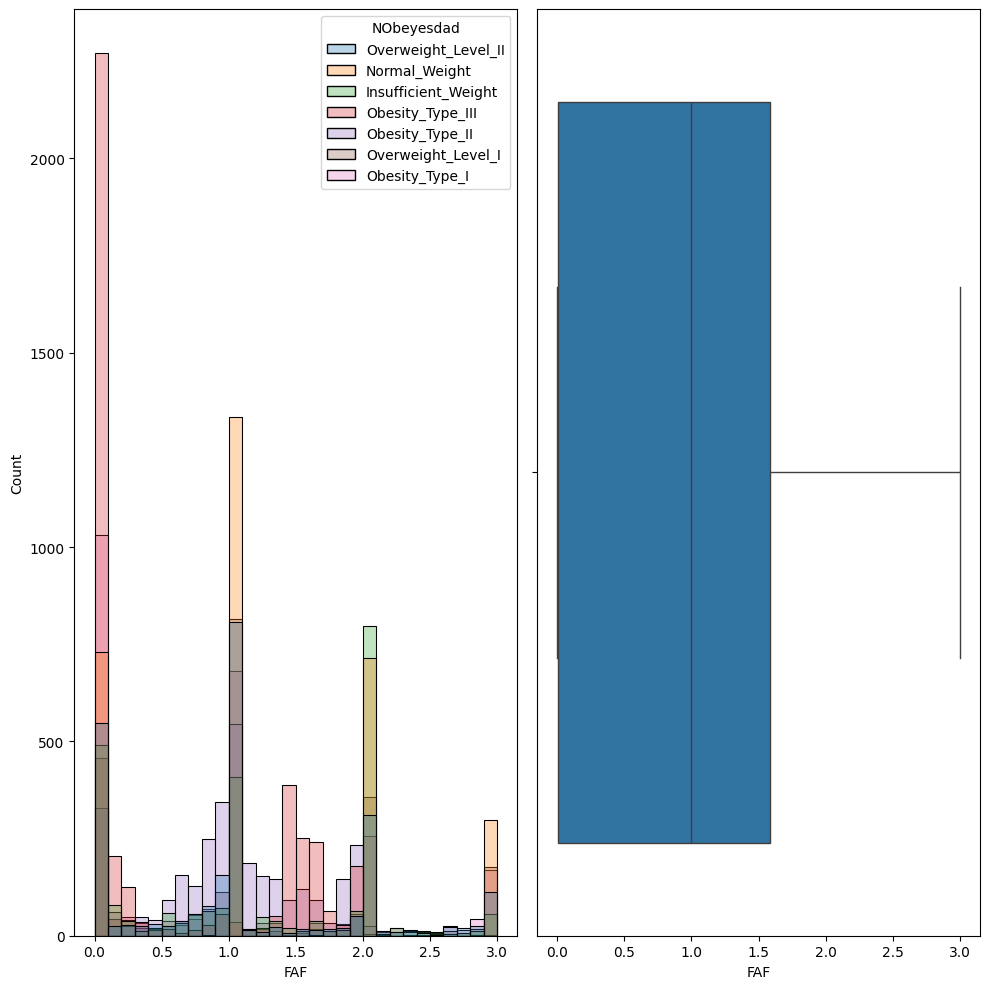

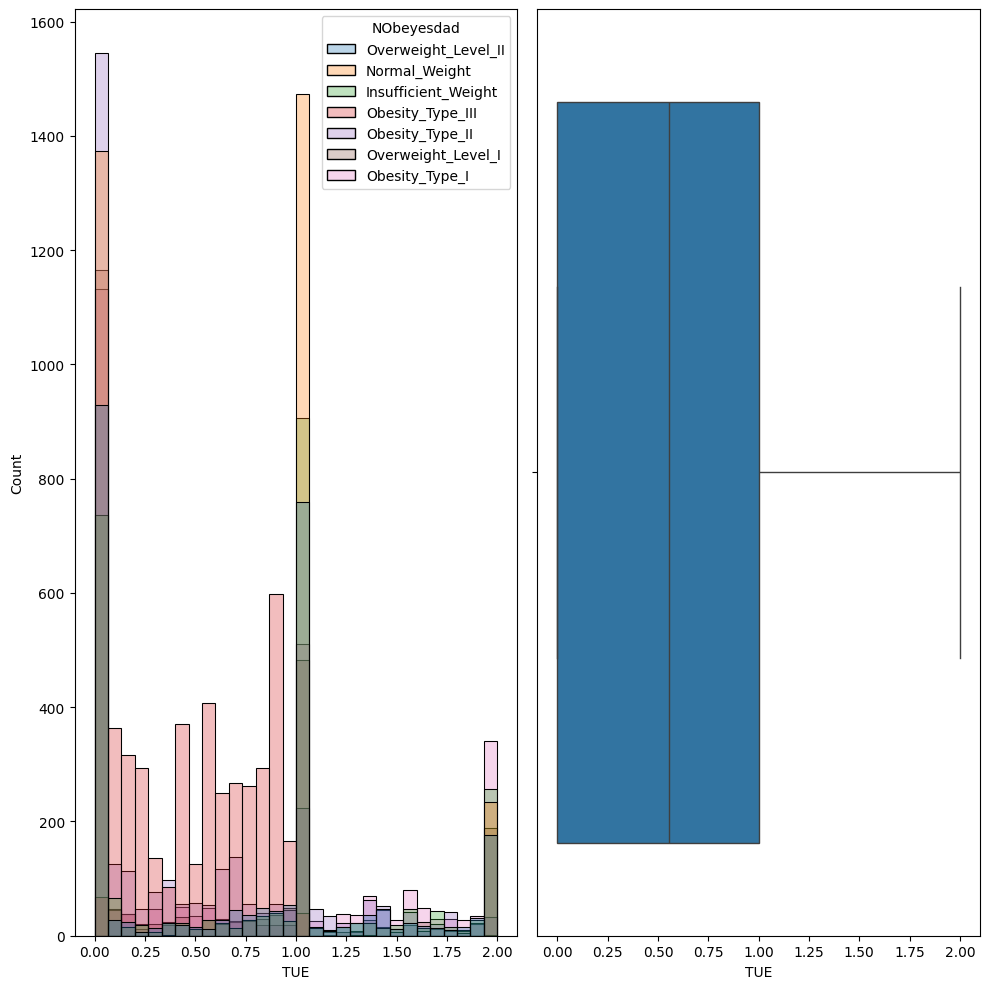

In [26]:
to_analysis_num(df,num_cols)

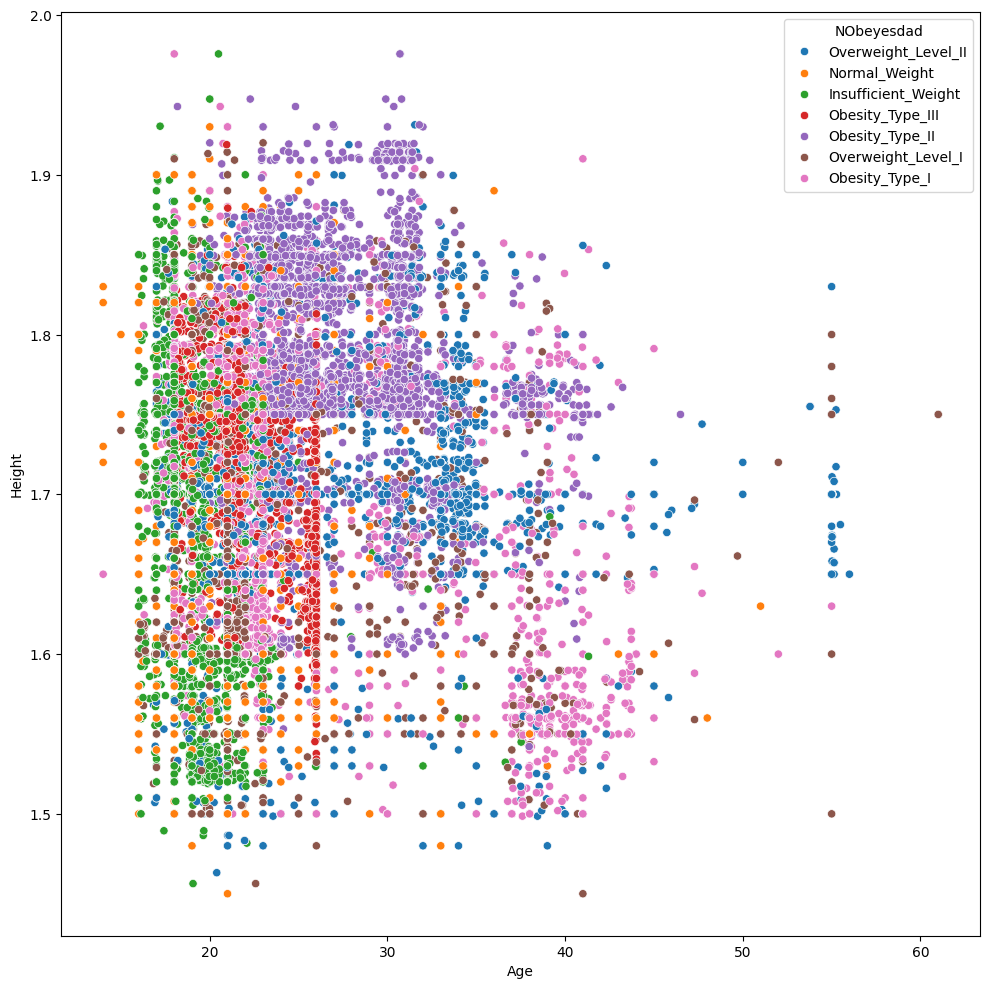

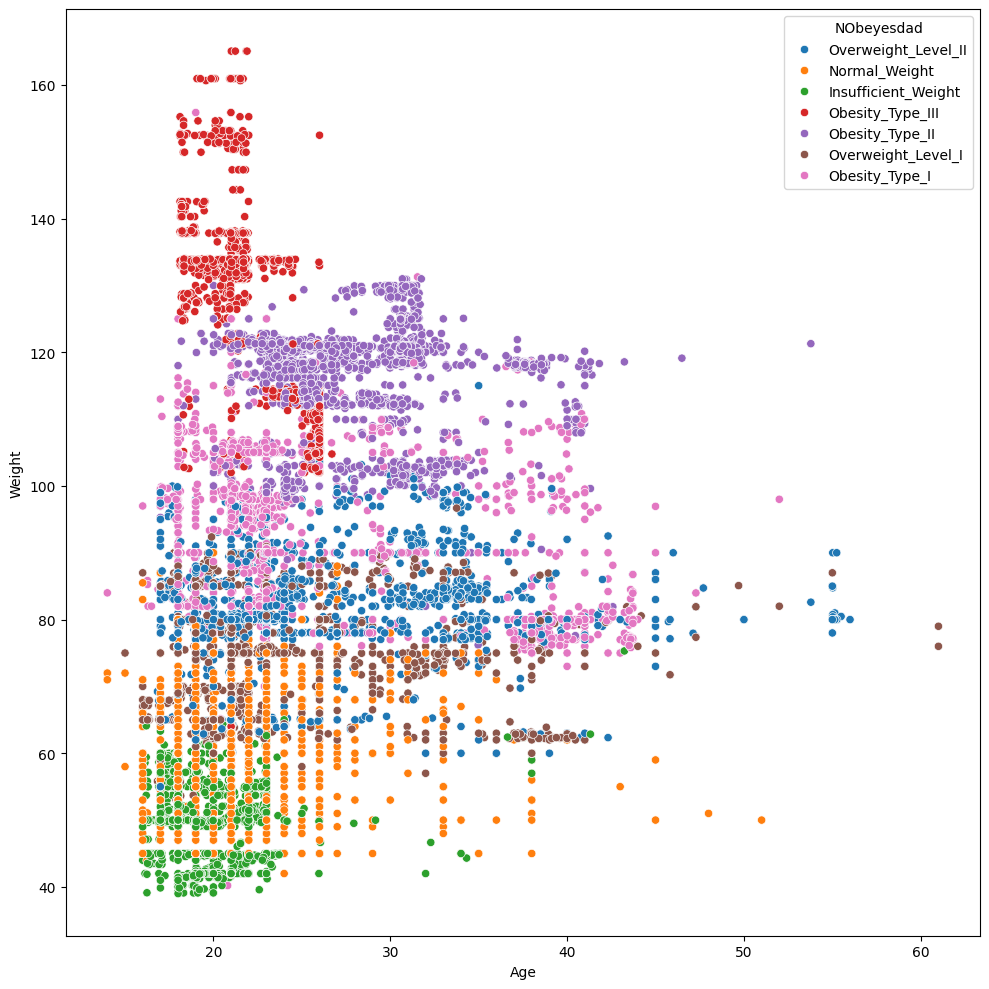

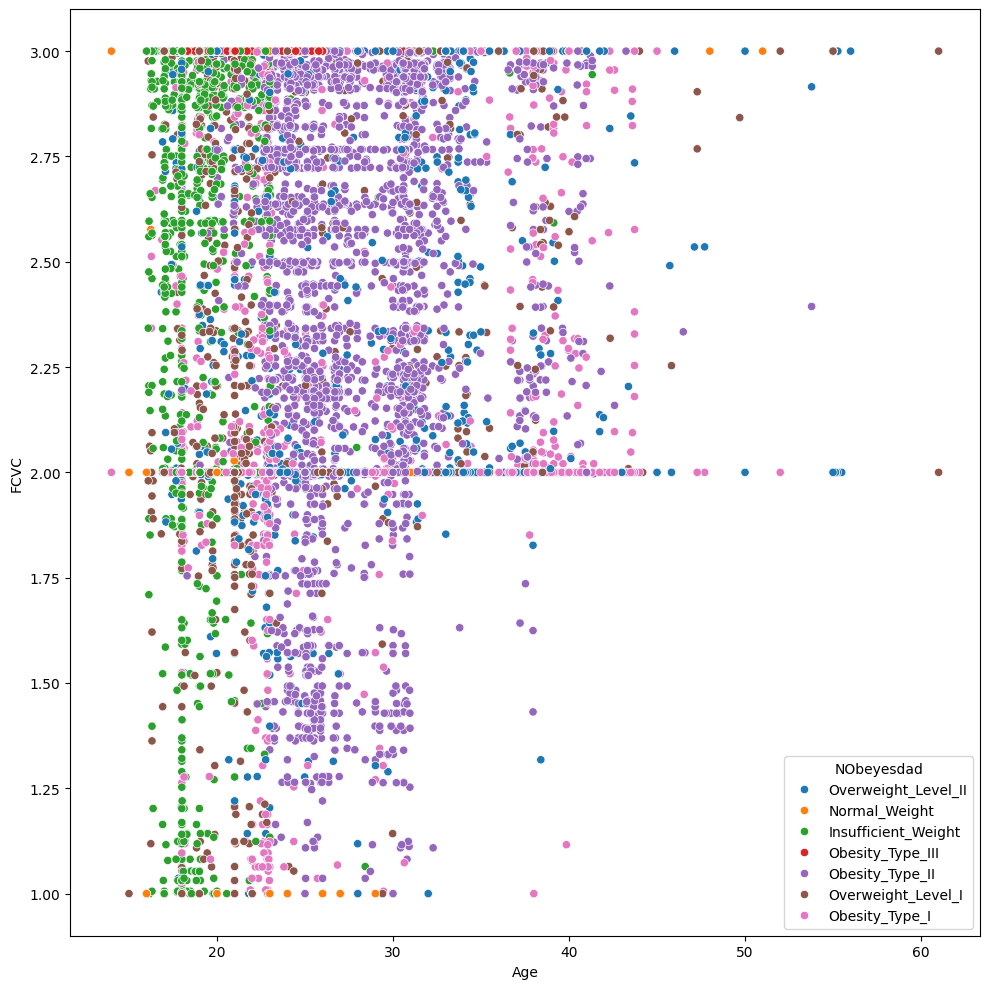

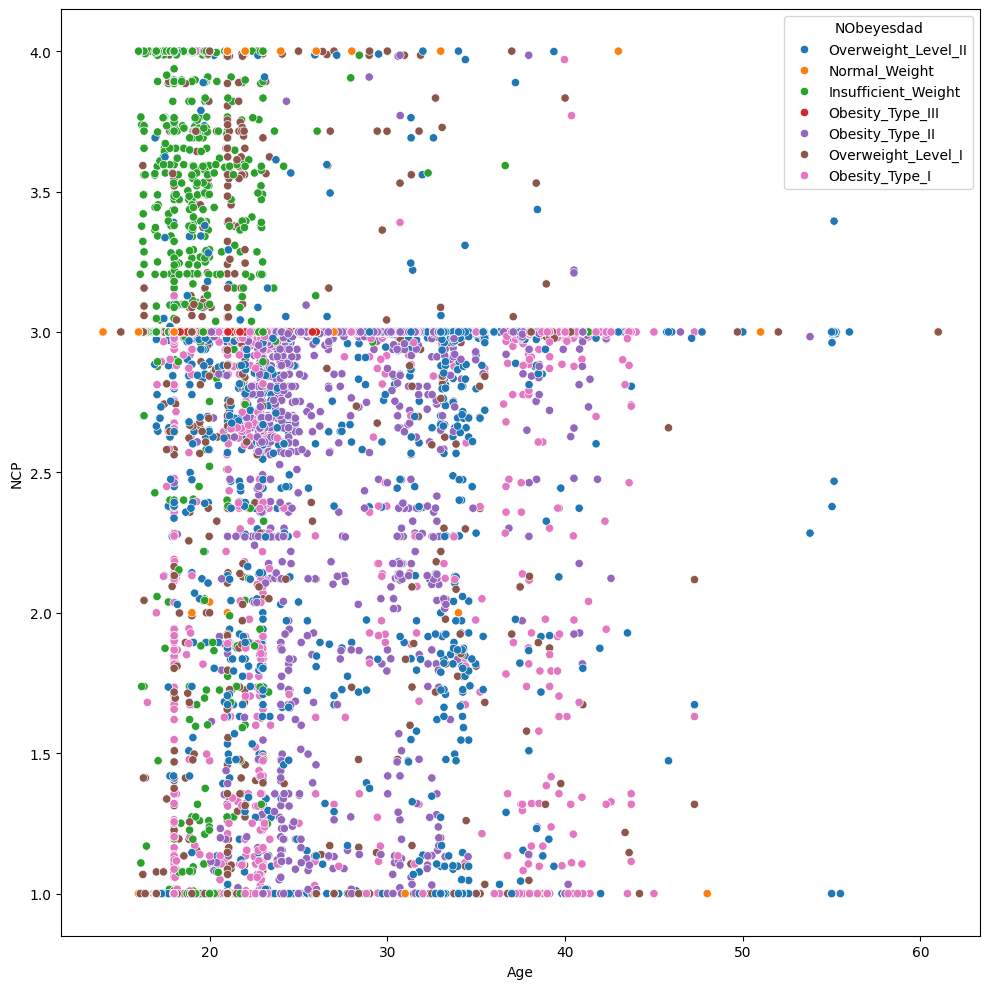

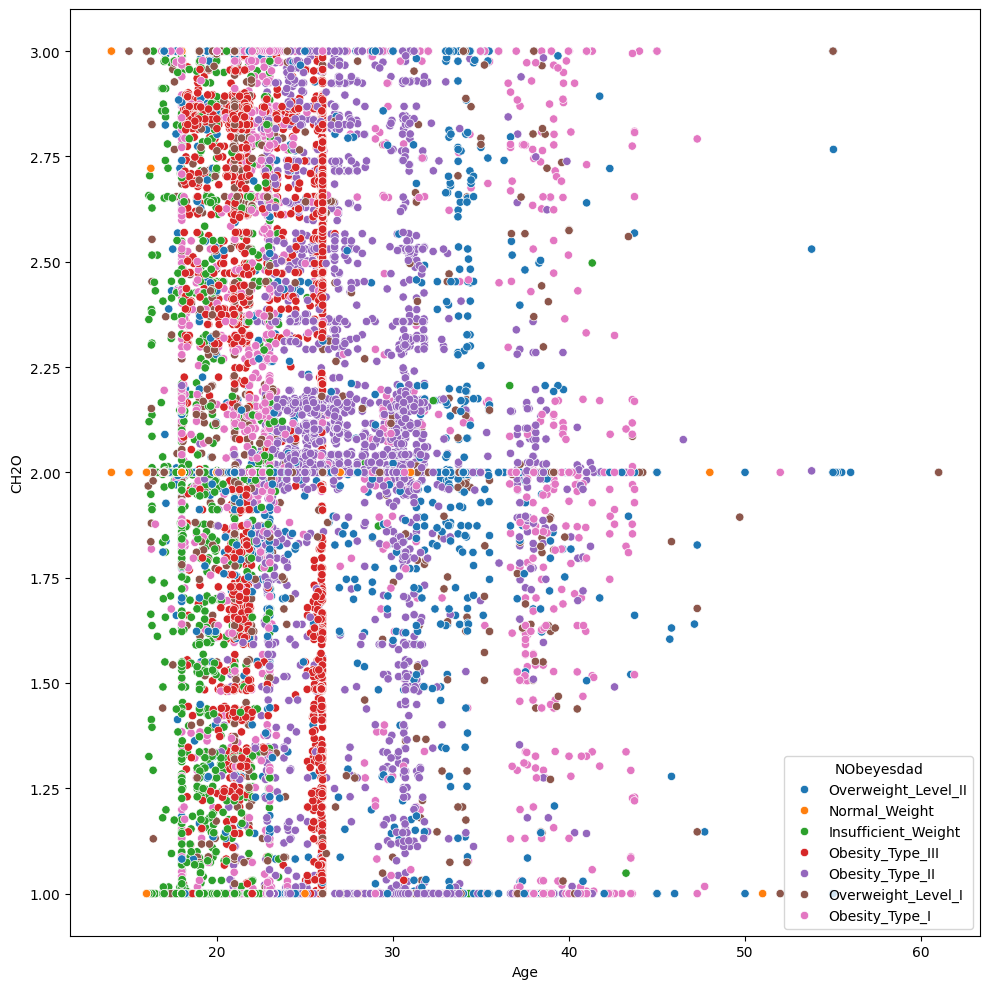

...

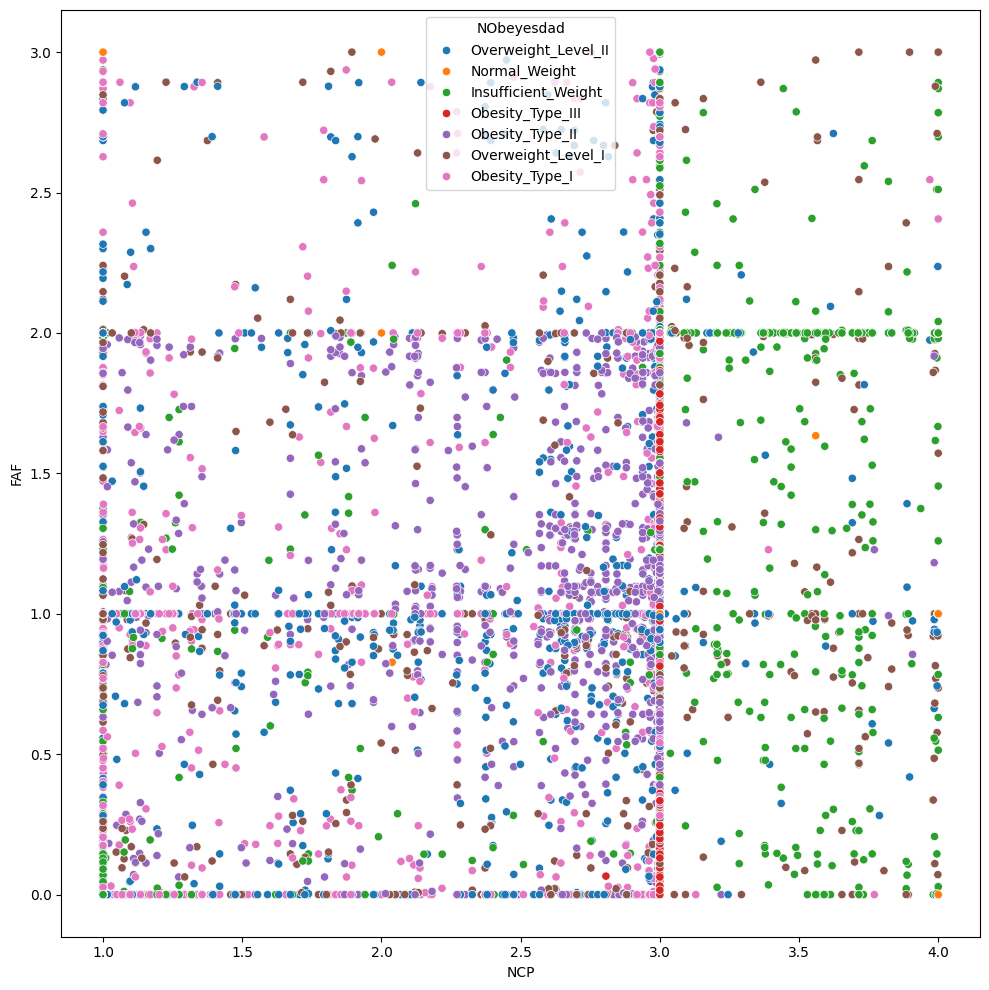

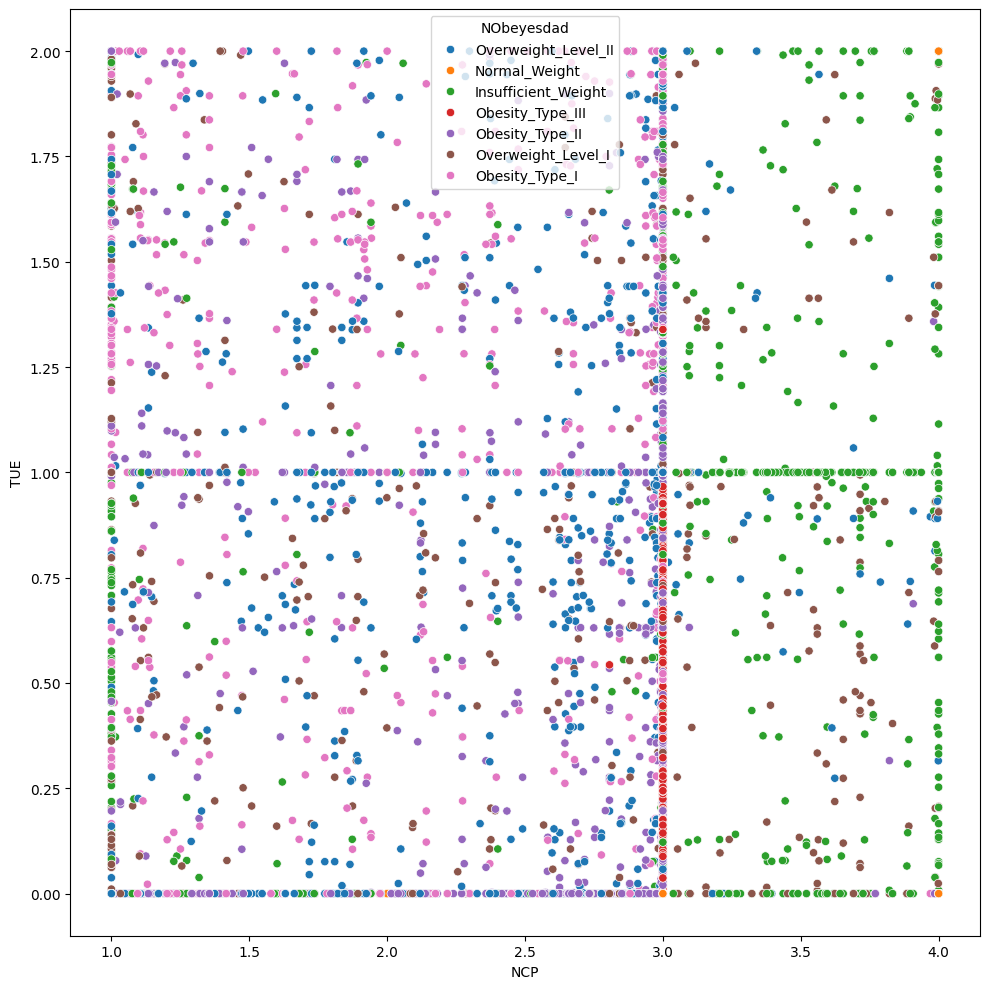

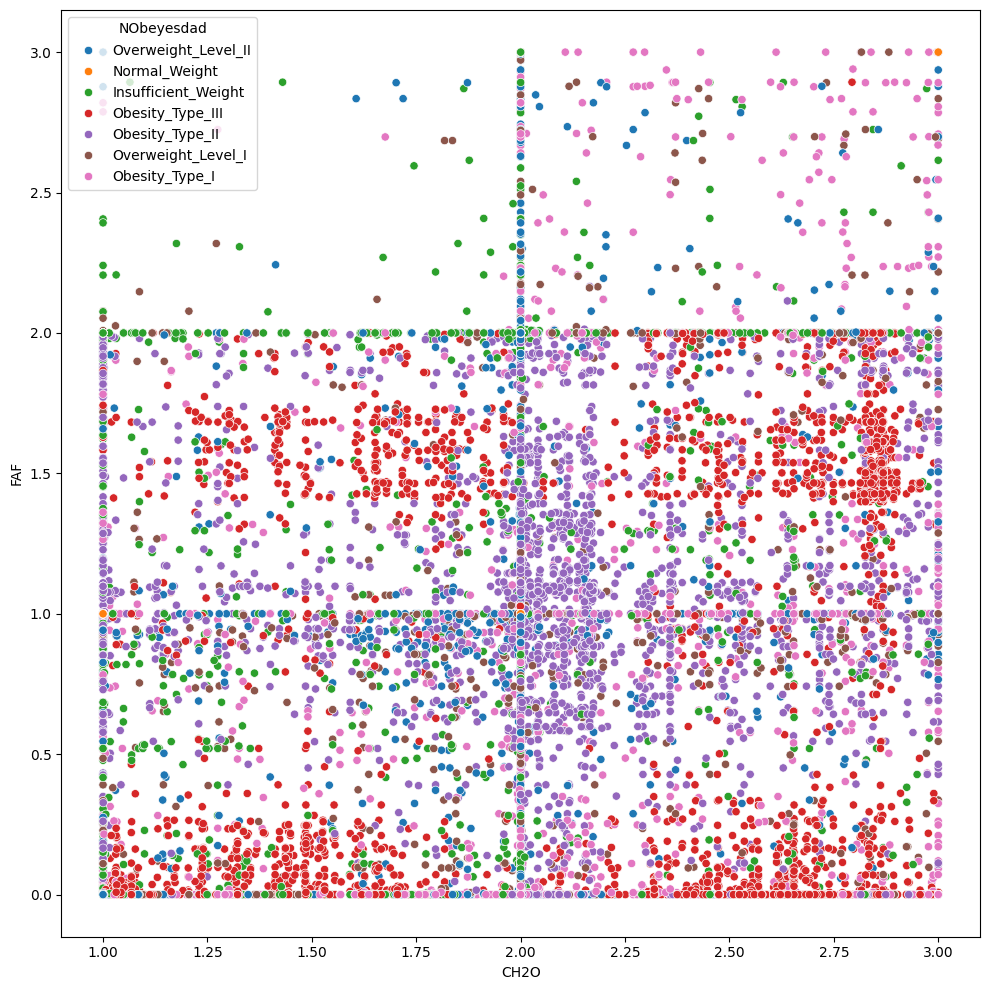

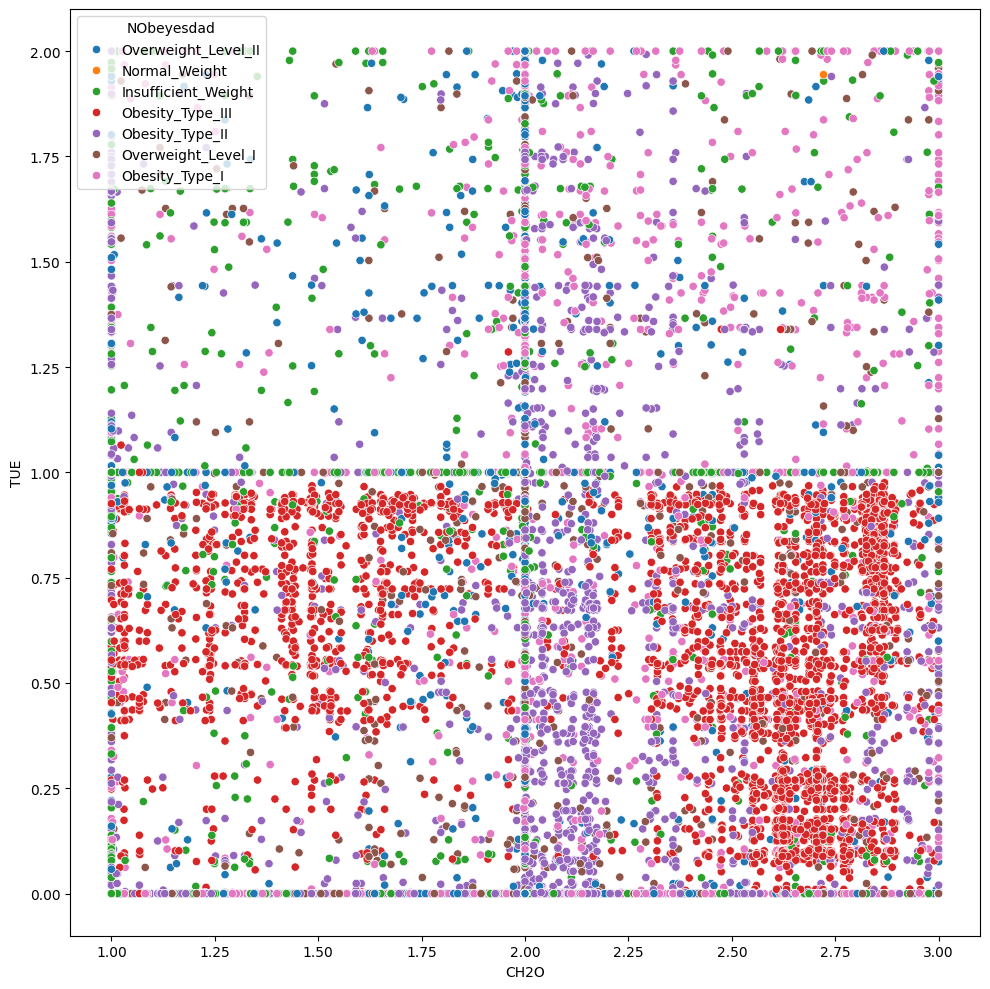

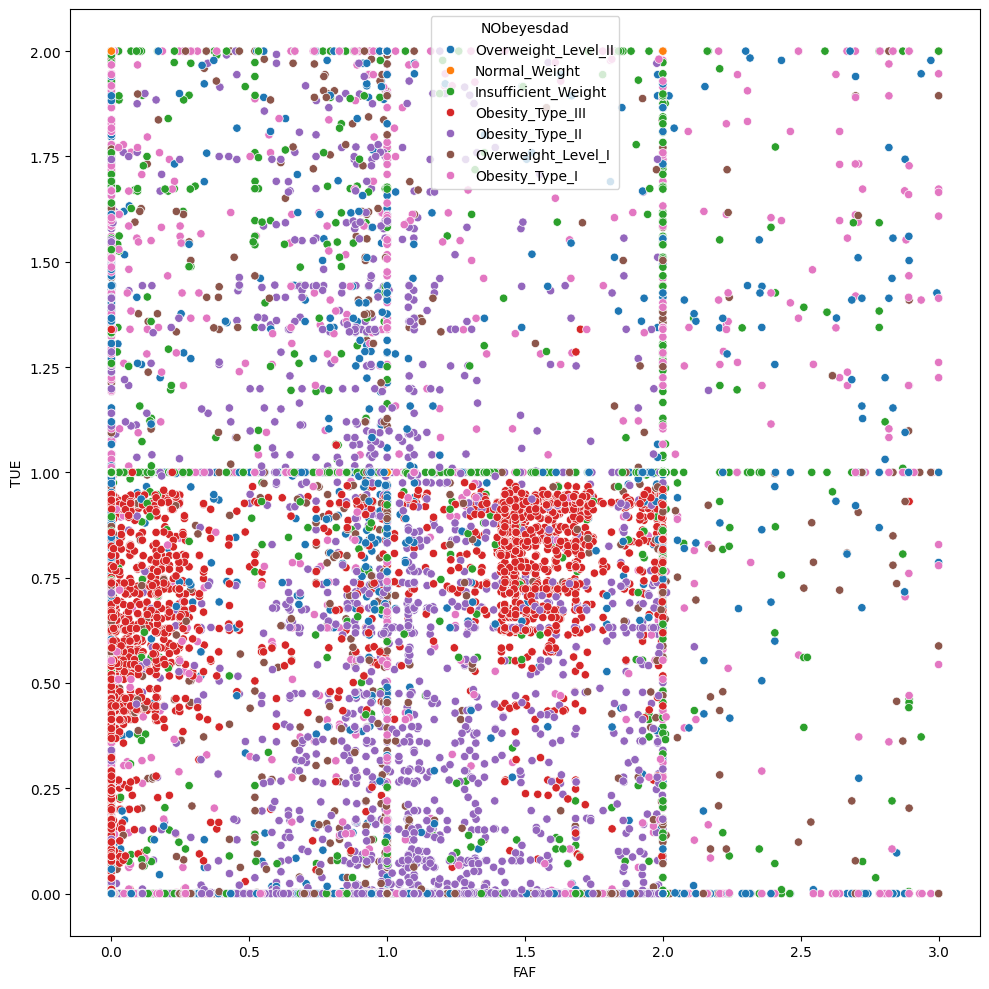

In [27]:
for i in range(len(num_cols)):
    for j in range(i+1,len(num_cols)):
        plt.figure(figsize=(10,10))
        sns.scatterplot(df,x=num_cols[i],y=num_cols[j],hue="NObeyesdad")
        plt.xlabel(num_cols[i])
        plt.ylabel(num_cols[j])
        plt.tight_layout()
        plt.show()

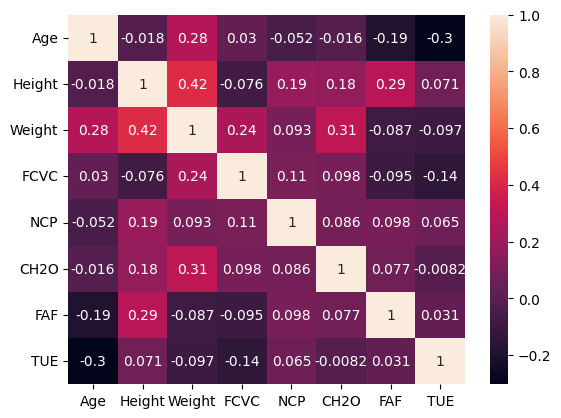

In [28]:
corr= df[num_cols].corr()

sns.heatmap(corr, annot=True)
plt.show()

<font size='5'>Outlier Analysis</font>

In [29]:
def outlier_thresholds(dataframe, col_name, q1=0.05, q3=0.95):
    quartile1 = dataframe[col_name].quantile(q1)
    quartile3 = dataframe[col_name].quantile(q3)
    interquantile_range = quartile3 - quartile1
    up_limit = quartile3 + 1.5 * interquantile_range
    low_limit = quartile1 - 1.5 * interquantile_range
    return low_limit, up_limit

In [30]:
def check_outlier(dataframe, col_name):
    low_limit, up_limit = outlier_thresholds(dataframe, col_name)
    if dataframe[(dataframe[col_name] > up_limit) | (dataframe[col_name] < low_limit)].any(axis=None):
        return True
    else:
        return False

In [31]:
for col in num_cols:
    print(col, check_outlier(df, col))

Age False
Height False
Weight False
FCVC False
NCP False
CH2O False
FAF False
TUE False


In [32]:
df

,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,CAEC,SMOKE,CH2O,SCC,FAF,TUE,CALC,MTRANS,NObeyesdad
0,Male,24.443011,1.699998,81.669950,yes,yes,2.000000,2.983297,Sometimes,no,2.763573,no,0.000000,0.976473,Sometimes,Public_Transportation,Overweight_Level_II
1,Female,18.000000,1.560000,57.000000,yes,yes,2.000000,3.000000,Frequently,no,2.000000,no,1.000000,1.000000,no,Automobile,Normal_Weight
2,Female,18.000000,1.711460,50.165754,yes,yes,1.880534,1.411685,Sometimes,no,1.910378,no,0.866045,1.673584,no,Public_Transportation,Insufficient_Weight
3,Female,20.952737,1.710730,131.274851,yes,yes,3.000000,3.000000,Sometimes,no,1.674061,no,1.467863,0.780199,Sometimes,Public_Transportation,Obesity_Type_III
4,Male,31.641081,1.914186,93.798055,yes,yes,2.679664,1.971472,Sometimes,no,1.979848,no,1.967973,0.931721,Sometimes,Public_Transportation,Overweight_Level_II
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34593,Male,23.327836,1.721384,78.030383,yes,no,2.813234,3.000000,Sometimes,no,1.000000,no,0.807076,0.778632,Sometimes,Public_Transportation,NaN
34594,Female,29.000000,1.590000,62.000000,no,yes,3.000000,3.000000,Sometimes,no,2.000000,no,0.000000,0.000000,Sometimes,Public_Transportation,NaN
34595,Female,22.935612,1.585547,44.376637,no,yes,3.000000,2.273740,Frequently,no,2.000000,no,1.949840,1.000000,Sometimes,Public_Transportation,NaN
34596,Male,21.000000,1.620000,53.000000,yes,yes,2.000000,3.000000,Sometimes,no,2.000000,no,3.000000,2.000000,no,Public_Transportation,NaN


<font size='5'>Missing Values</font>

In [33]:
df.isnull().sum()

Gender                                0
Age                                   0
Height                                0
Weight                                0
family_history_with_overweight        0
FAVC                                  0
FCVC                                  0
NCP                                   0
CAEC                                  0
SMOKE                                 0
CH2O                                  0
SCC                                   0
FAF                                   0
TUE                                   0
CALC                                  0
MTRANS                                0
NObeyesdad                        13840
dtype: int64

There are no missing values in the dataset

<font size='10'>Feature Engineering</font>

**Feature Extraction**

In [34]:
df['Age_Weight']=(df['Age']*df['Weight']).astype('float')

df['Age_FCVC']=(df['Age']*df['FCVC']).astype('float')

df['BMI']=(df["Weight"]/df["Height"]**2).astype('float')

df['Height_Weight']=(df['Height']*df["Weight"]).astype('float')

df["Weight_FCVC"]=(df['Weight']*df["FCVC"]).astype('float')

df['Weight_NCP']=(df['Weight']*df['NCP']).astype('float')

df['Weight_CH2O']=(df['Weight']*df['CH2O']).astype('float')

df['Weight_FAF']=(df['Weight']*df['FAF']).astype('float')

df['Weight_TUE']=(df['Weight']*df['TUE']).astype('float')

In [35]:
cat_cols,num_cols,cat_but_car=classify(df)

Observation:  34598
variables: 26
cat_cols:  9
num_cols:  17
cat_but_car:  0


**Find highly correlated features**

In [36]:
def Find_highly_correlated_cols(df, corr_th=0.9):
    corr= df.corr(numeric_only=True)
    cor_matrix=corr.abs()

    upper_triangle_cols=cor_matrix.where(np.triu(np.ones(cor_matrix.shape),k=1).astype(bool))

    highly_correlated_cols=set()

    for col in upper_triangle_cols.columns:
        print(upper_triangle_cols[col])
        if any(upper_triangle_cols[col])>corr_th:
            highly_correlated_cols.add(col)
    return list(highly_correlated_cols)

**label encoding**

In [37]:
label_encoder=LabelEncoder()
cat_cols,num_cols,cat_but_car=classify(df)

binary_cols=[col for col in cat_cols if df[col].nunique()==2]
for col in binary_cols:
    df[col]=label_encoder.fit_transform(df[col])




Observation:  34598
variables: 26
cat_cols:  9
num_cols:  17
cat_but_car:  0


In [38]:
cat_cols

['Gender',
 'family_history_with_overweight',
 'FAVC',
 'CAEC',
 'SMOKE',
 'SCC',
 'CALC',
 'MTRANS',
 'NObeyesdad']

In [39]:
num_cols

['Age',
 'Height',
 'Weight',
 'FCVC',
 'NCP',
 'CH2O',
 'FAF',
 'TUE',
 'Age_Weight',
 'Age_FCVC',
 'BMI',
 'Height_Weight',
 'Weight_FCVC',
 'Weight_NCP',
 'Weight_CH2O',
 'Weight_FAF',
 'Weight_TUE']

**One-hot Encoding**

In [40]:
cat_cols=[col for col in cat_cols if col not in binary_cols and col!="NObeyesdad"]

df=pd.get_dummies(df,columns=cat_cols,drop_first=True,dtype=int)


In [41]:
df

,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,SMOKE,CH2O,...,CAEC_Frequently,CAEC_Sometimes,CAEC_no,CALC_Frequently,CALC_Sometimes,CALC_no,MTRANS_Bike,MTRANS_Motorbike,MTRANS_Public_Transportation,MTRANS_Walking
0,1,24.443011,1.699998,81.669950,1,1,2.000000,2.983297,0,2.763573,...,0,1,0,0,1,0,0,0,1,0
1,0,18.000000,1.560000,57.000000,1,1,2.000000,3.000000,0,2.000000,...,1,0,0,0,0,1,0,0,0,0
2,0,18.000000,1.711460,50.165754,1,1,1.880534,1.411685,0,1.910378,...,0,1,0,0,0,1,0,0,1,0
3,0,20.952737,1.710730,131.274851,1,1,3.000000,3.000000,0,1.674061,...,0,1,0,0,1,0,0,0,1,0
4,1,31.641081,1.914186,93.798055,1,1,2.679664,1.971472,0,1.979848,...,0,1,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34593,1,23.327836,1.721384,78.030383,1,0,2.813234,3.000000,0,1.000000,...,0,1,0,0,1,0,0,0,1,0
34594,0,29.000000,1.590000,62.000000,0,1,3.000000,3.000000,0,2.000000,...,0,1,0,0,1,0,0,0,1,0
34595,0,22.935612,1.585547,44.376637,0,1,3.000000,2.273740,0,2.000000,...,1,0,0,0,1,0,0,0,1,0
34596,1,21.000000,1.620000,53.000000,1,1,2.000000,3.000000,0,2.000000,...,0,1,0,0,0,1,0,0,1,0


**Data Scaling**

In [42]:
scaler=StandardScaler()

df[num_cols]=scaler.fit_transform(df[num_cols])


<font size='10'>Modeling</font>

In [43]:
train_set=df.iloc[:20758]
test_set=df.iloc[20758:]
test_set.drop('NObeyesdad',axis=1,inplace=True)

C:\Users\Dell\AppData\Local\Temp\ipykernel_21700\1187482008.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_set.drop('NObeyesdad',axis=1,inplace=True)


In [44]:
y=train_set.NObeyesdad
X=train_set.drop('NObeyesdad',axis=1)

In [45]:
X

,Gender,Age,Height,Weight,family_history_with_overweight,FAVC,FCVC,NCP,SMOKE,CH2O,...,CAEC_Frequently,CAEC_Sometimes,CAEC_no,CALC_Frequently,CALC_Sometimes,CALC_no,MTRANS_Bike,MTRANS_Motorbike,MTRANS_Public_Transportation,MTRANS_Walking
0,1,0.097125,0.003156,-0.228998,1,1,-0.835030,0.319748,0,1.202683,...,0,1,0,0,1,0,0,0,1,0
1,0,-1.026697,-1.589647,-1.167979,1,1,-0.835030,0.343353,0,-0.049985,...,1,0,0,0,0,1,0,0,0,0
2,0,-1.026697,0.133563,-1.428102,1,1,-1.059354,-1.901298,0,-0.197013,...,0,1,0,0,0,1,0,0,1,0
3,0,-0.511666,0.125258,1.659050,1,1,1.042690,0.343353,0,-0.584699,...,0,1,0,0,1,0,0,0,1,0
4,1,1.352648,2.440044,0.232618,1,1,0.441189,-1.110191,0,-0.083045,...,0,1,0,0,1,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20753,1,0.218189,0.761205,1.008660,1,1,0.891692,0.343353,0,0.199063,...,0,1,0,0,1,0,0,0,1,0
20754,1,-1.026697,0.116953,-1.434411,0,1,1.042690,1.756581,0,-1.690520,...,1,0,0,0,1,0,0,0,1,0
20755,1,-0.660226,1.363419,0.681078,1,1,-0.069264,0.343353,0,-0.049985,...,0,1,0,0,0,1,0,0,1,0
20756,1,1.738454,0.003179,-0.158578,1,1,0.425367,-1.110191,0,0.187627,...,0,1,0,0,0,1,0,0,0,0


In [46]:
y

0        Overweight_Level_II
1              Normal_Weight
2        Insufficient_Weight
3           Obesity_Type_III
4        Overweight_Level_II
                ...         
20753        Obesity_Type_II
20754    Insufficient_Weight
20755        Obesity_Type_II
20756    Overweight_Level_II
20757        Obesity_Type_II
Name: NObeyesdad, Length: 20758, dtype: object

In [47]:
X_train,X_val,y_train,y_val=train_test_split(X,y,test_size=0.2,random_state=42)

<font size='5'>Logicstic Regression</font>

In [48]:
model=LogisticRegression()

model.fit(X_train,y_train)

pred=model.predict(X_val)

print(accuracy_score(y_val,pred))


0.8704238921001927


c:\Users\Dell\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


<font size='5'>Support Vector Machine</font>

In [49]:
model= SVC()

params_grid = {
    'C': [1, 10, 100],
    'kernel': ['poly', 'rbf', 'sigmoid']
}



**Hyperparameter Tuning**

In [50]:
# Define a GridSearchCV to search the best parameters
grid_search = GridSearchCV(estimator = model, 
                           param_grid = params_grid, 
                           scoring='f1',
                           cv = 5, verbose = 1)
# Search the best parameters with training data
grid_search.fit(X_train, y_train.values.ravel())
best_params = grid_search.best_params_

Fitting 5 folds for each of 9 candidates, totalling 45 fits


c:\Users\Dell\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py:993: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "c:\Users\Dell\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 982, in _score
    scores = scorer(estimator, X_test, y_test, **score_params)
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Dell\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_scorer.py", line 253, in __call__
    return self._score(partial(_cached_call, None), estimator, X, y_true, **_kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\Dell\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\metrics\_scorer.py", line 345, in _score
    y_pred = method_caller(
     

In [51]:
best_params

{'C': 1, 'kernel': 'poly'}

In [52]:
model = SVC(C=100, kernel='rbf')
model.fit(X_train, y_train.values.ravel())
preds = model.predict(X_val)
print(accuracy_score(y_val, preds))

0.8651252408477842


<font size='5'>Random Forest</font>

In [58]:
# parameter
model = RandomForestClassifier()
model.get_params().keys()

dict_keys(['bootstrap', 'ccp_alpha', 'class_weight', 'criterion', 'max_depth', 'max_features', 'max_leaf_nodes', 'max_samples', 'min_impurity_decrease', 'min_samples_leaf', 'min_samples_split', 'min_weight_fraction_leaf', 'monotonic_cst', 'n_estimators', 'n_jobs', 'oob_score', 'random_state', 'verbose', 'warm_start'])

**Hyperameter Tuning** 

In [59]:
param_grid = {'n_estimators': [200,300],
             'max_depth' : [10,20 ],
             'max_features':["auto", "sqrt", "log2"]}

In [60]:
search = GridSearchCV(estimator=model, param_grid=param_grid,scoring='accuracy')
search.fit(X_train, y_train)

c:\Users\Dell\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py:547: FitFailedWarning: 
20 fits failed out of a total of 60.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
20 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Dell\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\model_selection\_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Dell\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py", line 1467, in wrapper
    estimator._validate_params()
  File "c:\Users\Dell\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\base.py", l

GridSearchCV(estimator=RandomForestClassifier(),
             param_grid={'max_depth': [10, 20],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'n_estimators': [200, 300]},
             scoring='accuracy')

In [61]:
search.best_params_

{'max_depth': 20, 'max_features': 'sqrt', 'n_estimators': 300}

In [62]:
pred=search.predict(X_val)

print(accuracy_score(pred,y_val))

0.9005298651252408


<font size='5'>Light Gradient Boosting Machine</font>

**Hyperparameter Tuning**

In [66]:
params = {
    "objective": "multiclass",          # Objective function for the model
    "metric": "multi_logloss",          # Evaluation metric
    "verbosity": -1,                    # Verbosity level (-1 for silent)
    "boosting_type": "gbdt",            # Gradient boosting type
    "random_state": 42,       # Random state for reproducibility
    "num_class": 7,                     # Number of classes in the dataset
    'learning_rate': 0.030962211546832760,  # Learning rate for gradient boosting
    'n_estimators': 500,                # Number of boosting iterations
    'lambda_l1': 0.009667446568254372,  # L1 regularization term
    'lambda_l2': 0.04018641437301800,   # L2 regularization term
    'max_depth': 10,                    # Maximum depth of the trees
    'colsample_bytree': 0.40977129346872643,  # Fraction of features to consider for each tree
    'subsample': 0.9535797422450176,    # Fraction of samples to consider for each boosting iteration
    'min_child_samples': 26             # Minimum number of data needed in a leaf
}

model=LGBMClassifier(**params)

model.fit(X_train,y_train)

params = {
    'lgbmc__num_leaves': [ 50, 70],
    'lgbmc__max_depth': [10, 20, 30],
    'learning_rate': [ 0.05, 0.01],
    'lgbmc__n_estimators': [100, 200],
    'lgbmc__min_child_samples': [ 30, 40],
    #'subsample': [0.6, 0.8, 1.0],
    #'colsample_bytree': [0.6, 0.8, 1.0],
    #'reg_alpha': [0, 0.1, 0.5],
    #'reg_lambda': [0, 0.1, 0.5]
}

grid = GridSearchCV(estimator=model, param_grid=params, cv=3, n_jobs=-1, verbose=1).fit(X_train, y_train)
model = grid.best_estimator_





Fitting 3 folds for each of 48 candidates, totalling 144 fits


AttributeError: 'LGBMClassifier' object has no attribute 'best_grid_model'

In [67]:
print(accuracy_score(y_val, model.predict(X_val)) )

0.9075144508670521


<font size='10'>**Conclusion**</font>

LGBM (Light Gradient Boosting Model) is the best model for the following reasons:
- High Efficiency and Speed
- Handling well large dataset 
- Better accuracy
- Flexibility

In [ ]:
output = pd.read_csv("Obesity_risk/sample_submission.csv")

prediction = model.predict(test_set)
output["NObeyesdad"] = prediction
output.to_csv("submission.csv", index=False)
output

,id,NObeyesdad
0,20758,Obesity_Type_II
1,20759,Overweight_Level_I
2,20760,Obesity_Type_III
3,20761,Obesity_Type_I
4,20762,Obesity_Type_III
...,...,...
13835,34593,Overweight_Level_II
13836,34594,Normal_Weight
13837,34595,Insufficient_Weight
13838,34596,Normal_Weight


<font size='10'>**Suggestion**</font>

- Need to use other visualizations (such as violin plot) in order to get more insights of the dataset
- Need to add more new features to increase the model of accuracy
- There are a lot of outliers, we need to get rid of them